In [56]:
#!/usr/bin/env Rscript 
library(dplyr)
library(Seurat)
library(httr)
library(readr)
library(pheatmap)
library(RColorBrewer)
library(ggplot2)
library(cowplot)
library(patchwork)
library(unixtools)
library(ggrepel)
library(repr)
library(ggmin)
library(harmony)
library(SeuratWrappers)
library(Nebulosa)
library(ggthemes)
set_config(config(ssl_verifypeer = 0L))
ulimit::memory_limit(100000)
set.tempdir("/datastore/lucy/tmp/")
setwd("/datastore/lucy/SynovialAtlas")
options(warn = -1, verbose=FALSE)

soft  hard 
1e+05   Inf

In [277]:
myeloid <- readRDS("./cache/myeloid.rds")

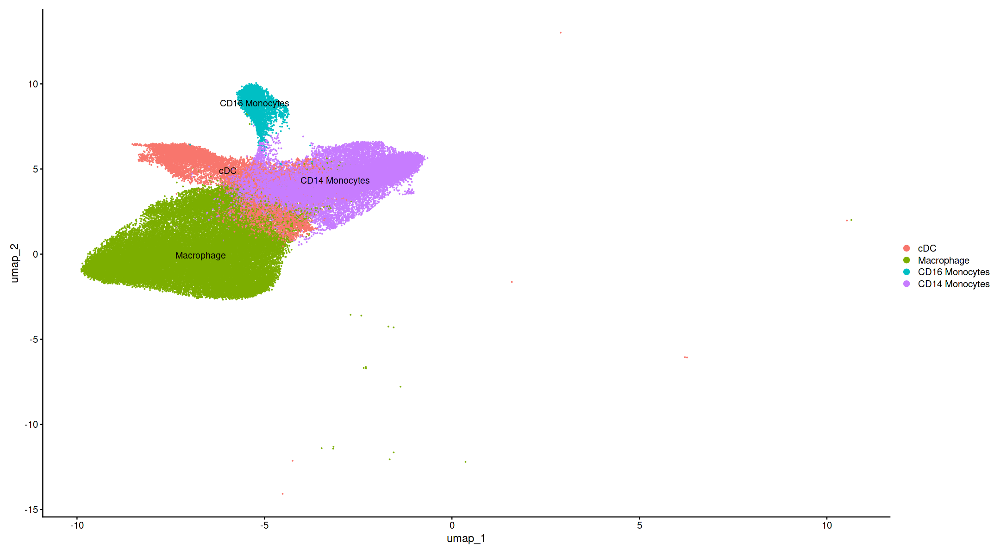

In [7]:
options(repr.plot.width=18, repr.plot.height=10)
DimPlot(myeloid, label=TRUE)

In [8]:
table(myeloid$celltype, myeloid$Tissue)

                   
                       PB    ST
  Sublining FLS         0     0
  Lining FLS            0     0
  Pericytes             0     0
  Endothelial cells     0     0
  Platelets             0     0
  CD4 T cells           0     0
  CD8 T cells           0     0
  NK cells              0     0
  B cells               0     0
  Plasma cells          0     0
  Mast cells            0     0
  pDC                   0     0
  cDC                1319  8384
  Macrophage           57 36415
  CD16 Monocytes     3397   398
  CD14 Monocytes    15299  7314
  Cycling               0     0

In [9]:
myeloid <- subset(myeloid, subset = Tissue == "ST")

In [10]:
myeloid.pb <- readRDS("/datastore/lucy/SynovialAtlas/CD1c/myeloid.pb.rds")

In [11]:
Idents(myeloid.pb) <- "integrated.pb.clusters"

In [12]:
pb.cols <- c('darkorchid4',"#FF00BF","red","orange",'#80FF00',"yellow",
                  '#00FFFF','#0040FF','#8000FF')

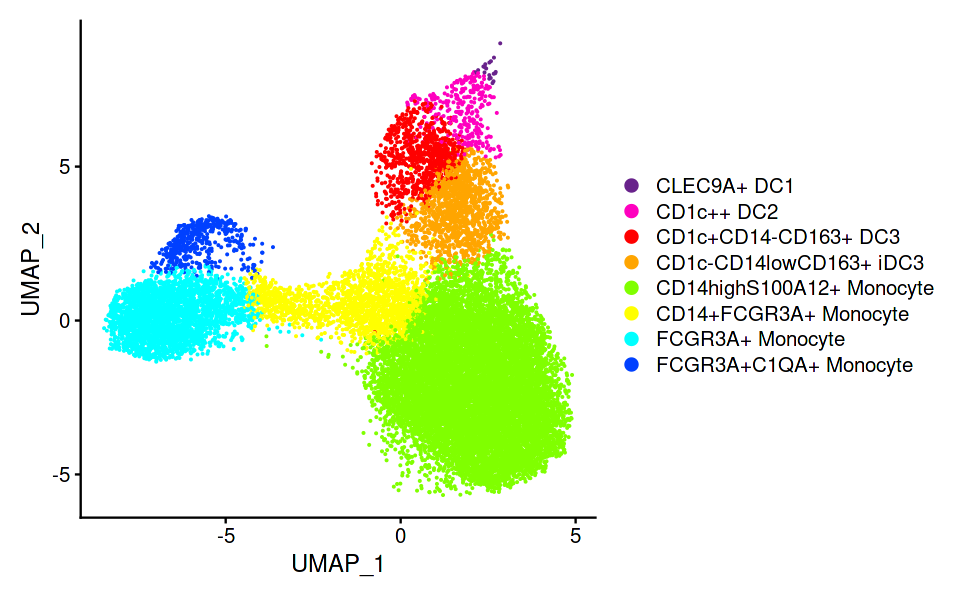

In [13]:
options(repr.plot.width=8, repr.plot.height=5)
DimPlot(myeloid.pb, label=FALSE, cols=pb.cols, reduction="intUMAP")

In [14]:
myeloid <- merge(myeloid, myeloid.pb)

In [17]:
#Continue with typical preprocessing pipeline
myeloid <- myeloid %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix

PC_ 1 
Positive:  C1QA, C1QB, RNASE1, C1QC, LMNA, CD63, LGMN, FTL, CTSL, GPNMB 
	   PLTP, VSIG4, FOLR2, MARCO, DAB2, EMP1, A2M, HLA-DPB1, CTSZ, HLA-DRB1 
	   NUPR1, PMP22, MSR1, CRIP1, CD81, HSPB1, CFD, FN1, MS4A4A, PRDX1 
Negative:  FCN1, CD48, RIPOR2, RAC2, LCP1, LYST, VSIR, FGR, LIMD2, VCAN 
	   MNDA, ITGA4, POU2F2, MEGF9, CD52, FYB1, LSP1, CASP1, SELL, CPPED1 
	   ITGAL, MPEG1, CSF3R, TXNIP, SAMHD1, SPN, CDC42EP3, SIRPB1, IL17RA, LYZ 
PC_ 2 
Positive:  RPS17, GPX1, ALDOA, LGALS1, TIMP1, ZNF90, HLA-DRB5, S100A6, C15orf48, LGALS2 
	   SDS, MIF, CFP, FABP5, IFI6, ISG20, SLC7A11, PSME2, MMP3, CXCR4 
	   MT2A, CRIP1, EREG, GPAT3, ISG15, MT1X, CST7, CREM, S100A10, S100A12 
Negative:  SELENOP, RACK1, JUN, MT-ATP6, FYB1, MT-ND5, KLF6, KLF4, ADA2, KLF2 
	   ZFP36L2, FOSB, RHOB, AHNAK, MT-ATP8, EGR1, SELENOK, MT-ND3, ZFP36L1, MT-ND4L 
	   ATP5MC3, ATP5MG, CCDC88A, TUT7, TXNIP, SELENOS, DST, MAF, ELOC, MAFB 
PC_ 3 
Positive:  NUPR1, CFD, ALDH1A1, IFI27, TIMD

In [18]:
#Preintegration
myeloid <- RunUMAP(object = myeloid, reduction = "pca", dims = 1:40)

10:26:05 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:26:05 Read 72295 rows and found 40 numeric columns

10:26:05 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:26:05 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:26:15 Writing NN index file to temp file /datastore/lucy/tmp//file18f36062642f62

10:26:15 Searching Annoy index using 1 thread, search_k = 3000

10:26:44 Annoy recall = 100%

10:26:46 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

10:26:49 Initializing from normalized Lapla

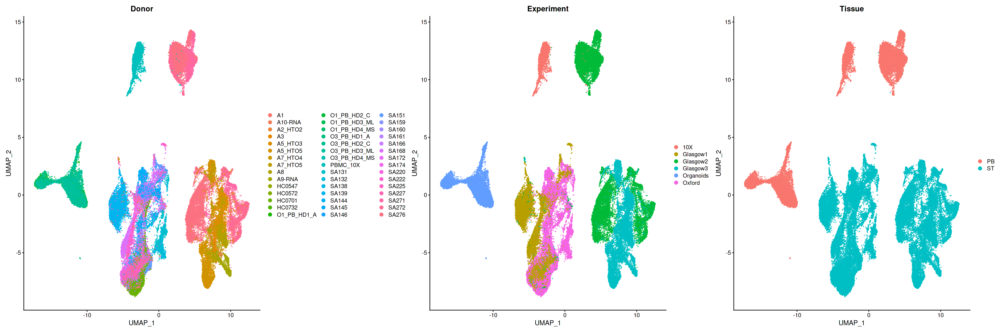

In [19]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue"))

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony converged after 5 iterations



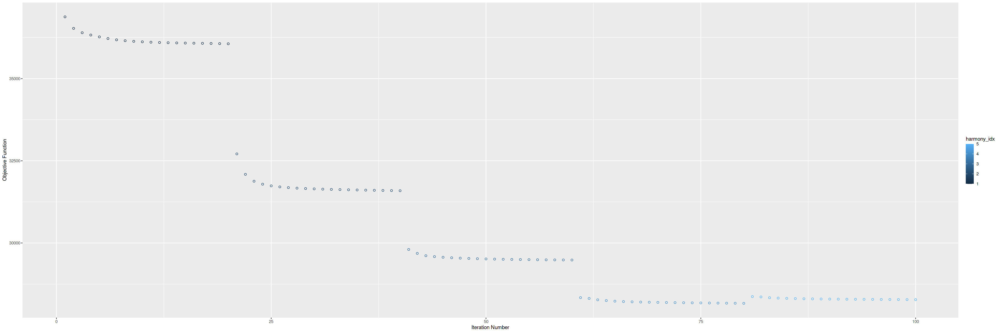

In [20]:
#Harmonize
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,2))

In [21]:
#Run UMAP and clustering
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=1)

10:38:41 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:38:41 Read 72295 rows and found 40 numeric columns

10:38:41 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

10:38:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:38:52 Writing NN index file to temp file /datastore/lucy/tmp//file18f3603ab6793d

10:38:52 Searching Annoy index using 1 thread, search_k = 3000

10:39:30 Annoy recall = 100%

10:39:31 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

10:39:35 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 72295
Number of edges: 2278936

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8488
Number of communities: 26
Elapsed time: 57 seconds


4 singletons identified. 22 final clusters.



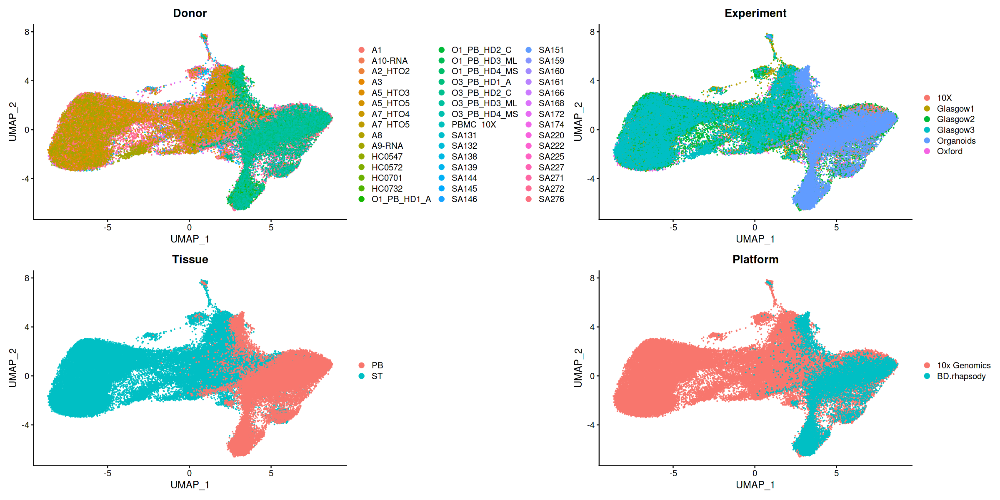

In [22]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, group.by=c("Donor","Experiment","Tissue","Platform"))

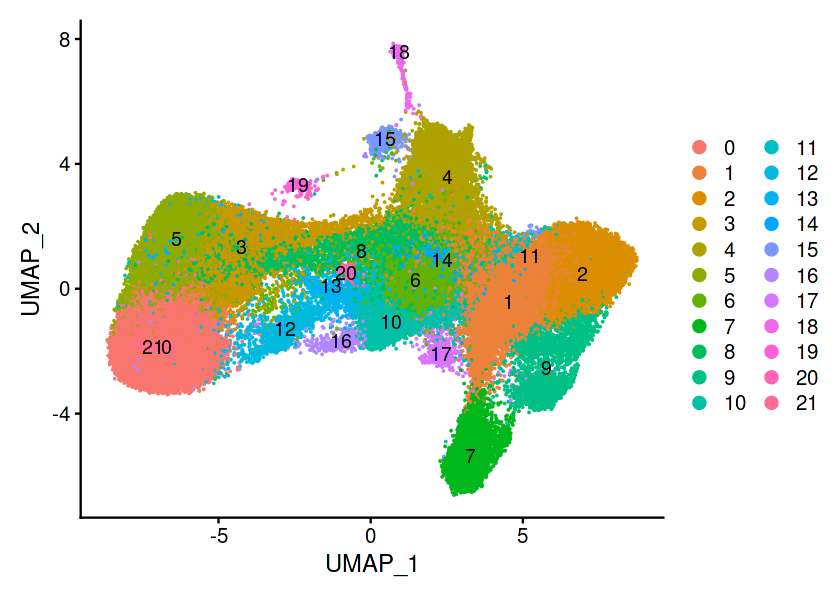

In [23]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

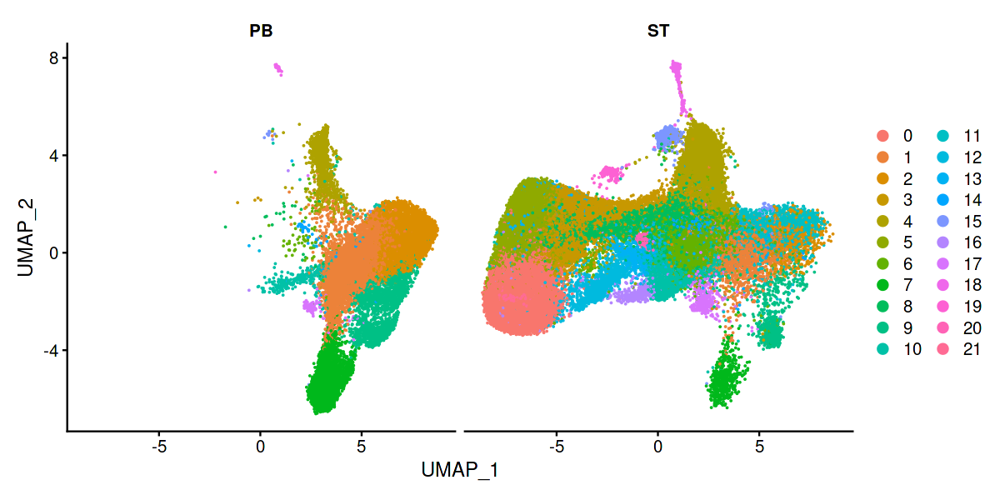

In [24]:
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(myeloid, split.by="Tissue")

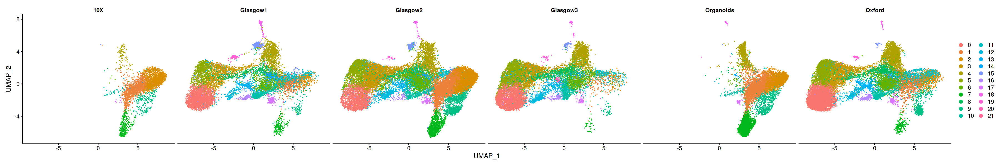

In [25]:
options(repr.plot.width=30, repr.plot.height=5)
DimPlot(myeloid, split.by="Experiment")

In [27]:
myeloid.subset <- subset(myeloid, downsample = 500)

In [28]:
cluster.markers <- FindAllMarkers(myeloid.subset, only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====

In [29]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [30]:
top10[top10$cluster=="21",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
2.973013e-24,2.629288,1.000,0.337,5.691239e-20,21,APOE
3.127886e-22,2.516567,1.000,0.283,5.987713e-18,21,APOC1
1.897797e-40,2.499058,1.000,0.062,3.632952e-36,21,LPL
1.729833e-29,2.393929,0.909,0.164,3.311420e-25,21,GCHFR
1.484928e-16,1.903403,1.000,0.505,2.842599e-12,21,FN1
1.961451e-16,1.787626,1.000,0.996,3.754806e-12,21,FTL
5.161820e-14,1.597119,1.000,0.970,9.881272e-10,21,NEAT1
4.132171e-14,1.453338,1.000,0.465,7.910216e-10,21,ATF3
3.358244e-13,1.386182,1.000,0.720,6.428686e-09,21,CTSD


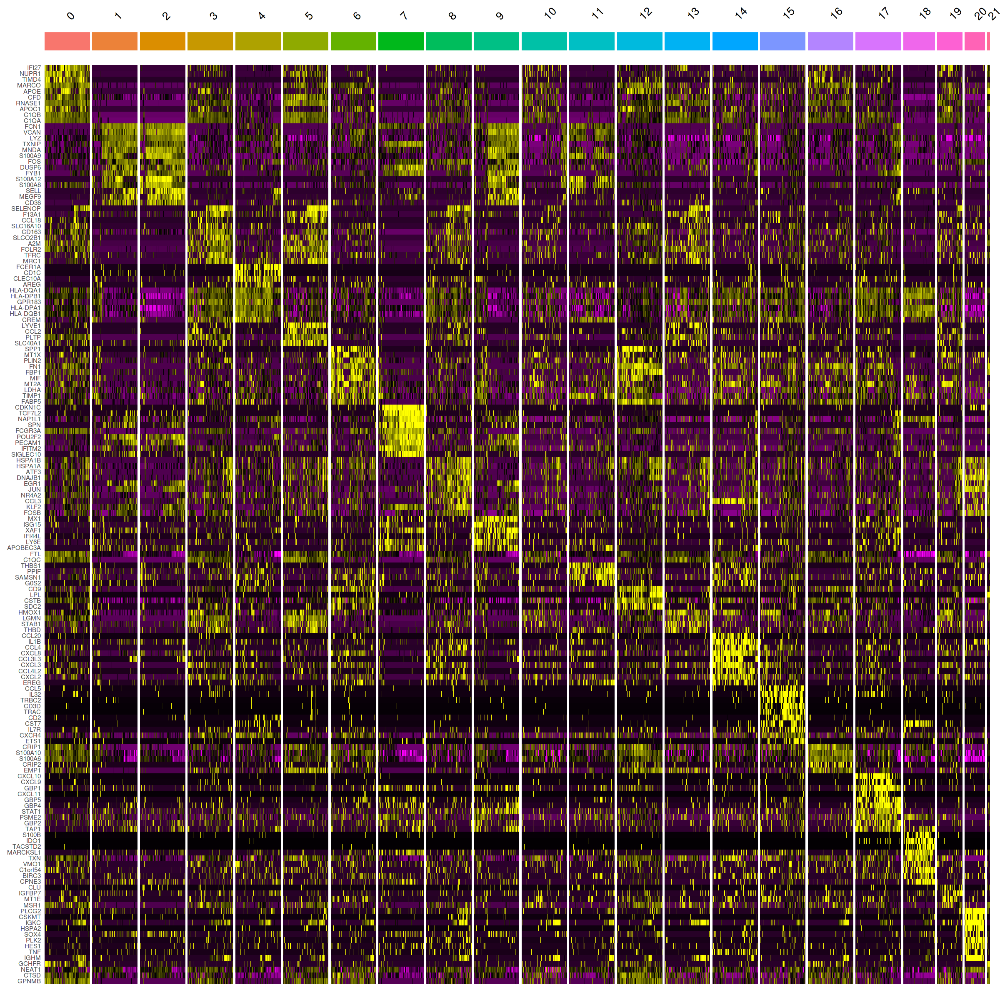

In [31]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(myeloid.subset, features=unique(top10$gene)) + NoLegend()

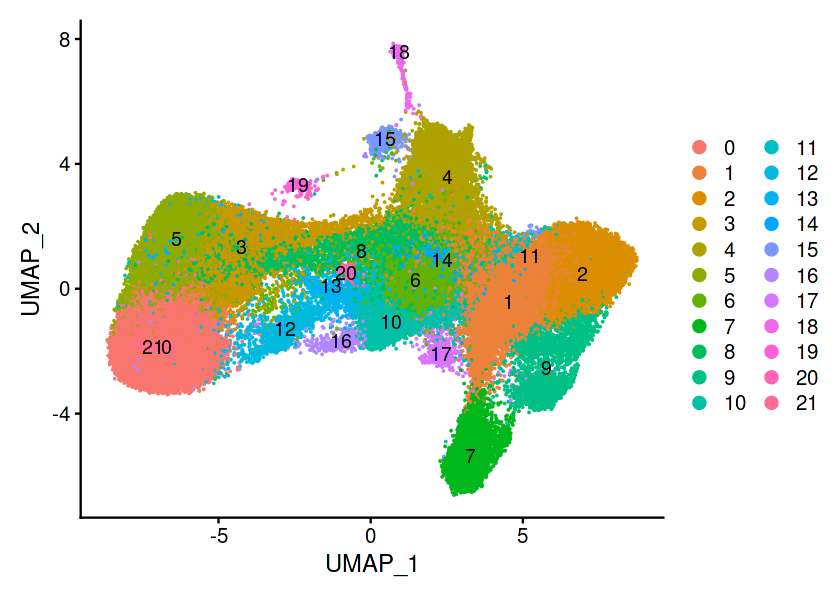

In [32]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

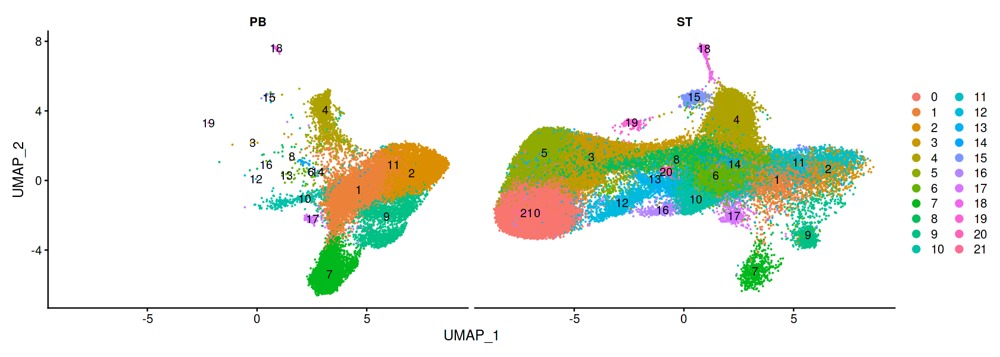

In [33]:
options(repr.plot.width=14, repr.plot.height=5)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [34]:
myeloid <- subset(myeloid, idents=c("15","19","20"), invert=TRUE)

Centering and scaling data matrix

PC_ 1 
Positive:  FCN1, CD48, RIPOR2, RAC2, LCP1, LYST, VSIR, FGR, LIMD2, VCAN 
	   MNDA, ITGA4, POU2F2, CD52, MEGF9, FYB1, LSP1, CASP1, SELL, ITGAL 
	   CPPED1, MPEG1, CSF3R, TXNIP, SAMHD1, SPN, CDC42EP3, SIRPB1, LYZ, IL17RA 
Negative:  C1QA, C1QB, RNASE1, C1QC, LMNA, CD63, FTL, LGMN, CTSL, GPNMB 
	   PLTP, VSIG4, FOLR2, MARCO, DAB2, EMP1, A2M, HLA-DPB1, HLA-DRB1, CTSZ 
	   NUPR1, CRIP1, MSR1, PMP22, CD81, HSPB1, CFD, FN1, MS4A4A, PRDX1 
PC_ 2 
Positive:  SELENOP, RACK1, MT-ATP6, JUN, FYB1, MT-ND5, KLF6, ADA2, KLF4, KLF2 
	   ZFP36L2, RHOB, FOSB, AHNAK, MT-ATP8, SELENOK, EGR1, MT-ND3, ZFP36L1, MT-ND4L 
	   ATP5MC3, ATP5MG, TUT7, CCDC88A, TXNIP, SELENOS, DST, MAF, ELOC, MAFB 
Negative:  RPS17, GPX1, ALDOA, LGALS1, TIMP1, ZNF90, HLA-DRB5, S100A6, C15orf48, LGALS2 
	   CFP, MIF, SDS, IFI6, FABP5, SLC7A11, PSME2, ISG20, CRIP1, CXCR4 
	   ISG15, GPAT3, MMP3, EREG, S100A10, MT2A, S100A12, CREM, CST7, MT1X 
PC_ 3 
Positive:  CREM, C15orf48, BTG1, AREG, GPR1

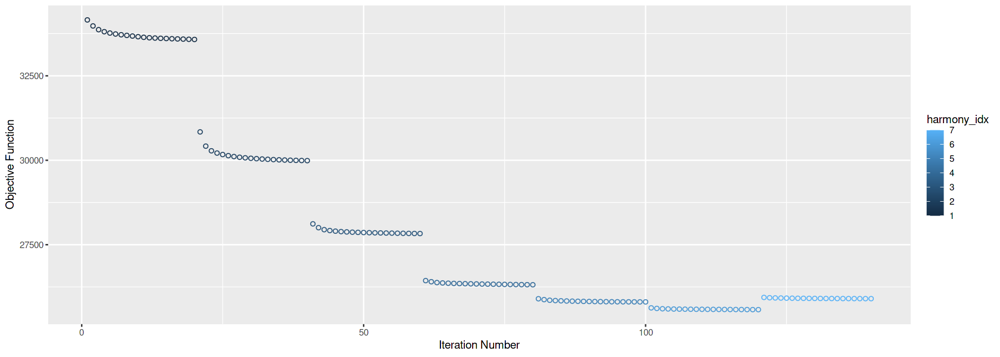

In [35]:
#Continue with typical preprocessing pipeline
myeloid <- FindVariableFeatures(myeloid, selection.method = "vst", nfeatures = 2000)
myeloid <- ScaleData(myeloid)
myeloid <- RunPCA(myeloid)
myeloid <- myeloid %>% 
    RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), plot_convergence = TRUE, theta=c(0,1,1,1))

In [43]:
#Run UMAP and clustering 
myeloid <- RunUMAP(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=1.5)

12:27:35 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:27:35 Read 71086 rows and found 40 numeric columns

12:27:35 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:27:35 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:27:46 Writing NN index file to temp file /datastore/lucy/tmp//file18f36026fe7484

12:27:46 Searching Annoy index using 1 thread, search_k = 3000

12:28:24 Annoy recall = 100%

12:28:25 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

12:28:28 Initializing from normalized Lapla

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 71086
Number of edges: 2267832

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8108
Number of communities: 29
Elapsed time: 53 seconds


3 singletons identified. 26 final clusters.



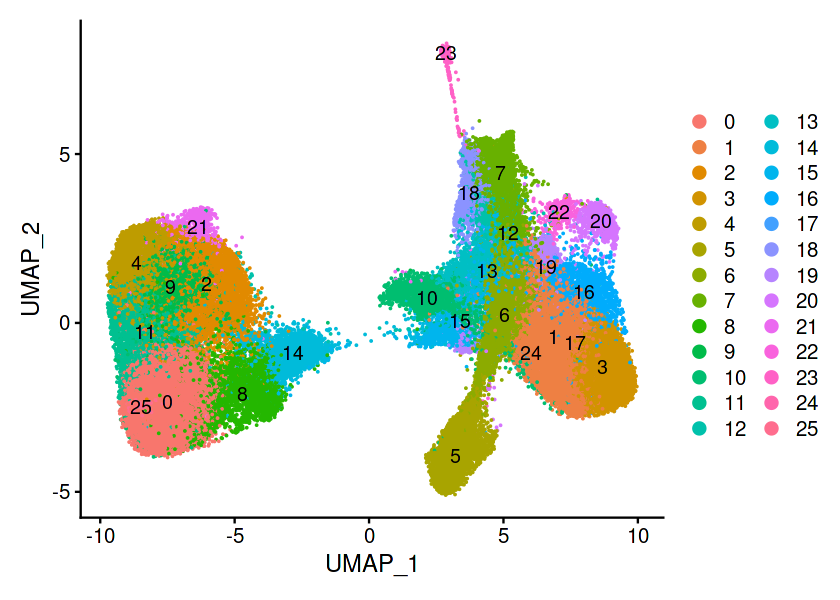

In [44]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

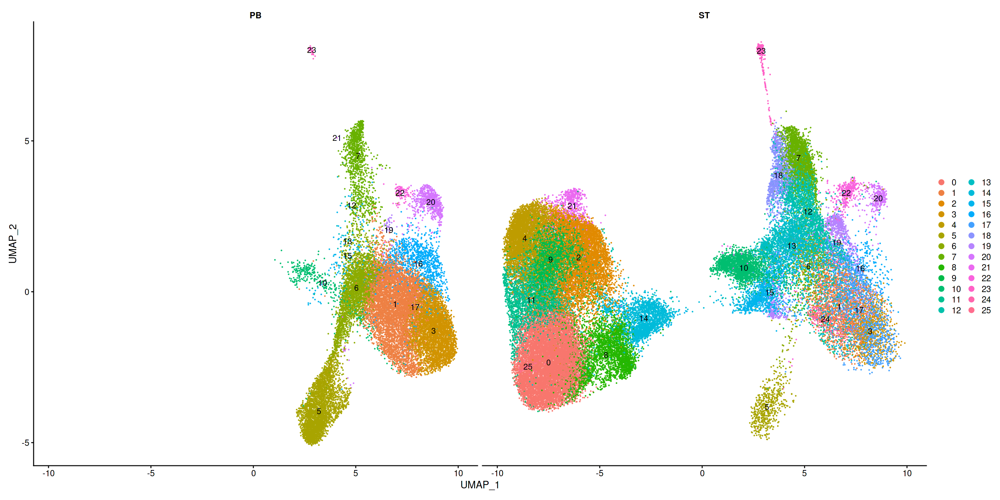

In [45]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [46]:
myeloid$integrated.pb.clusters <- as.ordered(factor(myeloid$integrated.pb.clusters, levels=c('CLEC9A+ DC1','CD1c++ DC2','CD1c+CD14-CD163+ DC3','CD1c-CD14lowCD163+ iDC3','CD14highS100A12+ Monocyte','CD14+FCGR3A+ Monocyte','FCGR3A+ Monocyte','FCGR3A+C1QA+ Monocyte')))


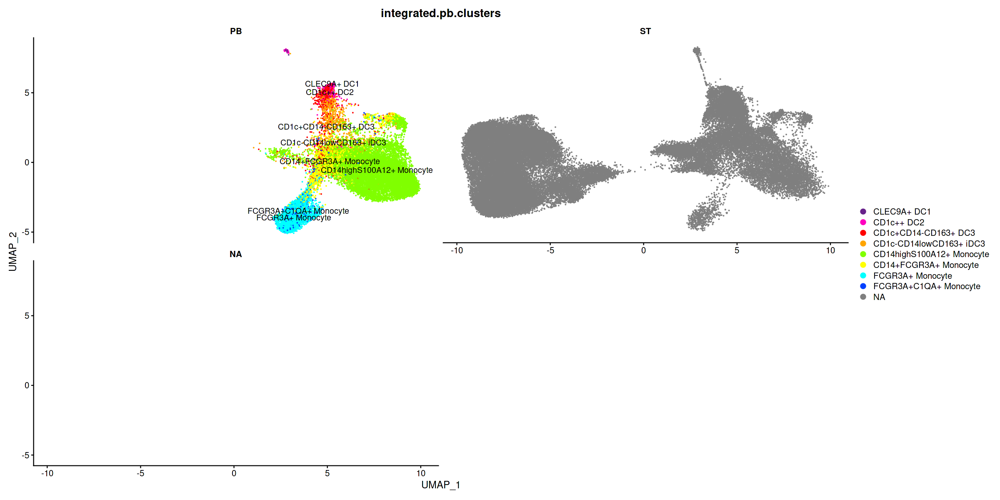

In [47]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, split.by="Tissue", group.by="integrated.pb.clusters",cols=pb.cols)

In [49]:
table(myeloid$seurat_clusters,myeloid$Tissue)

    
        PB    ST
  0      0 10171
  1   6093  1538
  2      0  6157
  3   3797   704
  4      0  4386
  5   3306   524
  6   2788   550
  7   1145  2149
  8      0  3264
  9      0  2942
  10   400  2400
  11     0  2425
  12     9  2284
  13    21  2236
  14     0  2245
  15   143  1523
  16  1177   348
  17     5  1469
  18     0  1092
  19    53   998
  20   687   299
  21     1   614
  22   116   409
  23    28   305
  24     0   250
  25     0    35

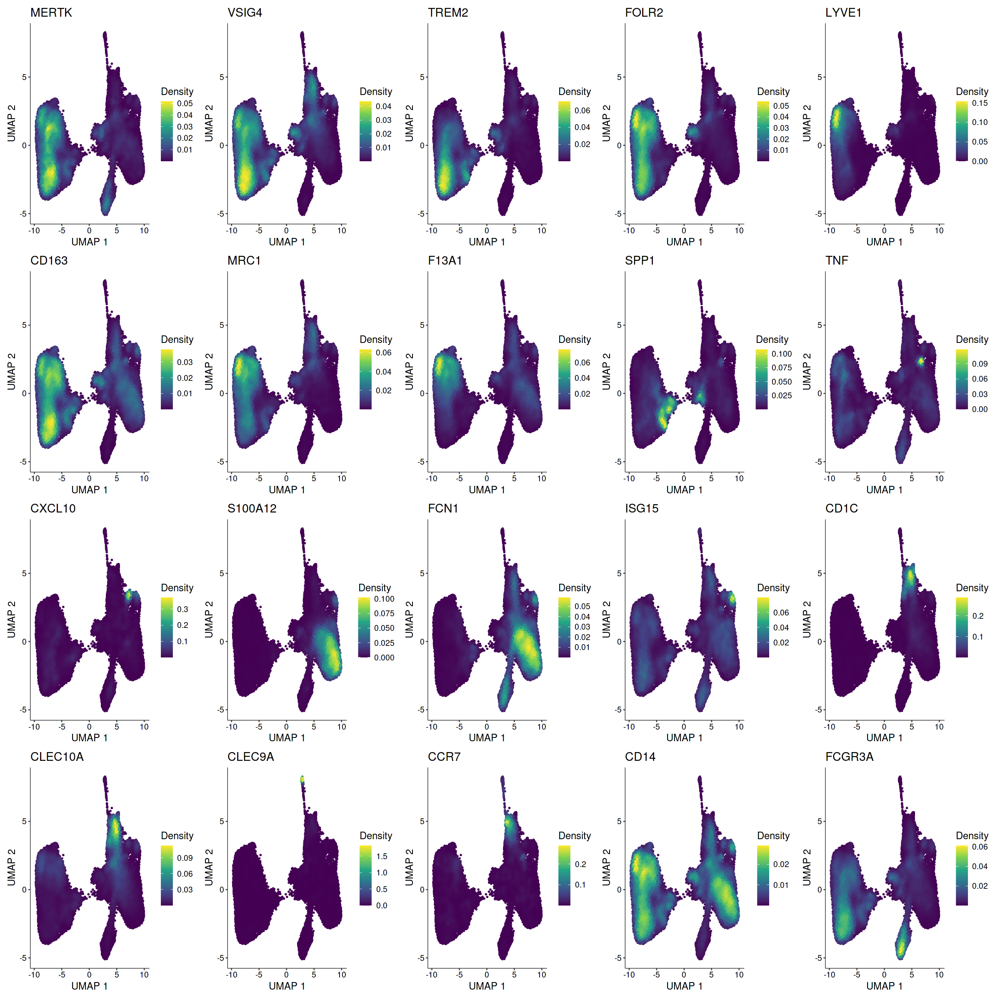

In [53]:
options(repr.plot.width=20, repr.plot.height=20)
plot_density(myeloid, features=genes, reduction="umap")

In [54]:
myeloid.subset <- subset(myeloid, downsample = 500)

In [55]:
myeloid.subset

An object of class Seurat 
19143 features across 12118 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

In [56]:
cluster.markers <- FindAllMarkers(myeloid.subset, only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [====

In [57]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

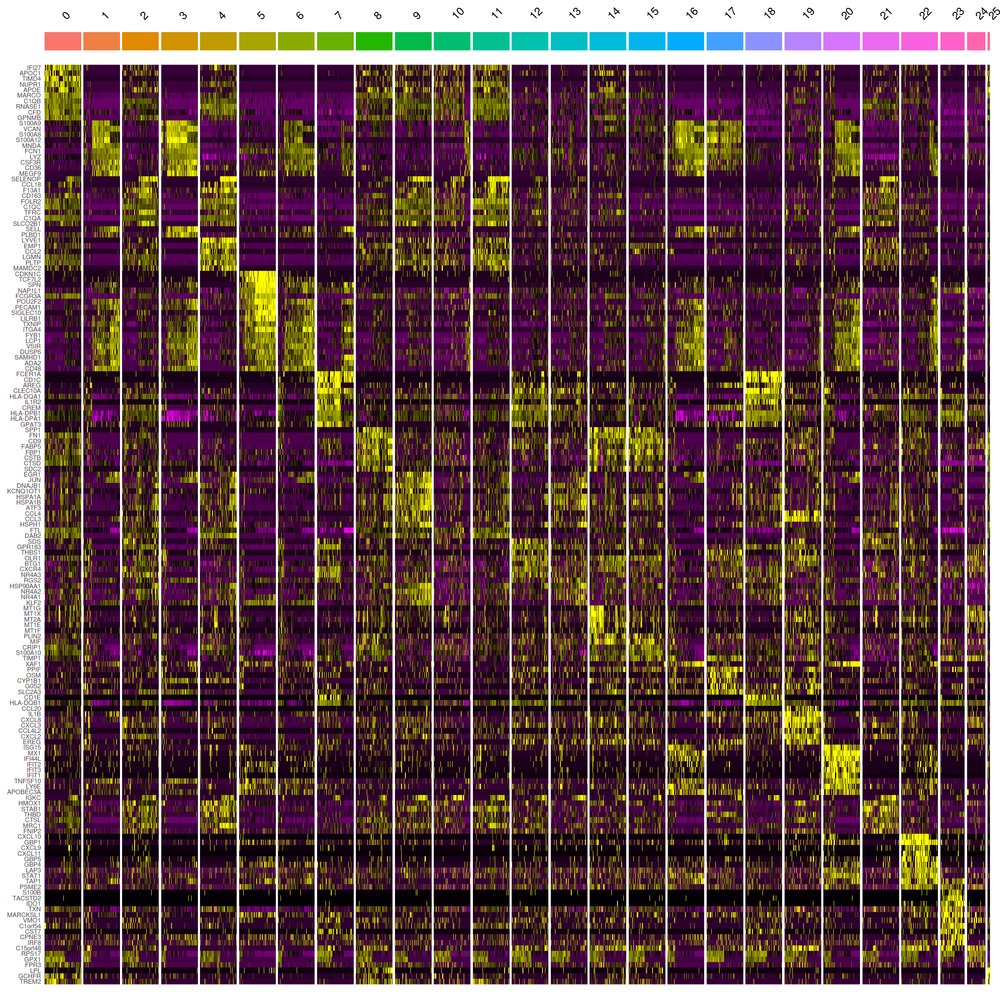

In [58]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(myeloid.subset, features=unique(top10$gene)) + NoLegend()

In [59]:
top10[top10$cluster=="25",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
3.377704e-29,2.926352,1.000,0.280,6.465939e-25,25,APOE
1.980852e-46,2.516949,1.000,0.051,3.791946e-42,25,LPL
4.348853e-37,2.485202,0.943,0.156,8.325009e-33,25,GCHFR
4.542492e-26,2.469360,1.000,0.257,8.695692e-22,25,APOC1
9.725317e-21,2.199134,1.000,0.446,1.861718e-16,25,FN1
5.240069e-20,1.933091,1.000,0.997,1.003106e-15,25,FTL
2.608921e-16,1.569605,1.000,0.491,4.994257e-12,25,MARCO
1.452534e-16,1.559552,1.000,0.726,2.780585e-12,25,CTSD
1.529852e-17,1.528841,1.000,0.424,2.928596e-13,25,GPNMB


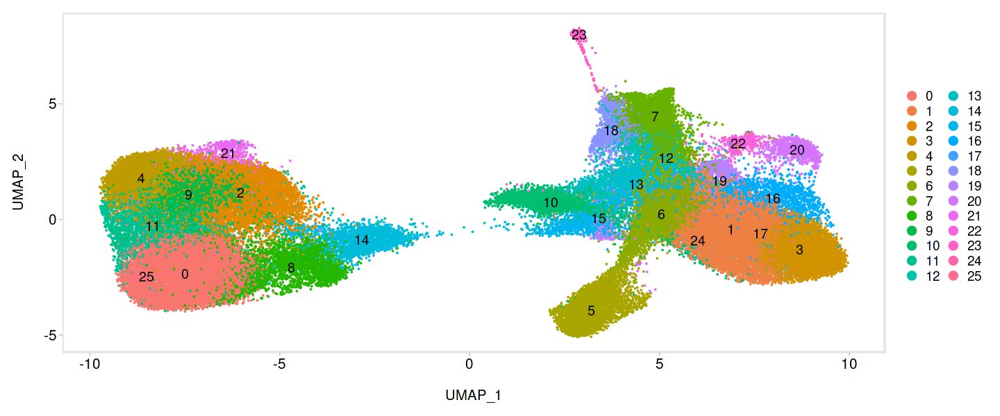

In [61]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(myeloid, label=TRUE) + theme_powerpoint()

In [62]:
#Remove cluster 21 as lyve1 macrophage/plasma cell doublets
myeloid <- subset(myeloid, idents="21", invert=TRUE)

In [73]:
#Rename your clusters by celltype
Idents(myeloid) <- "seurat_clusters"
myeloid$clusters.res1.5 <- plyr::revalue(as.character(Idents(myeloid)),
                                        c("0" = 'TREM2+ Macrophage',"1"='CD14highS100A12+ Monocyte',
                                          "2"='FOLR2highCLEC10A+ Macrophage',"3"='CD14highS100A12+ Monocyte',
                                         "4"='FOLR2highLYVE1+ Macrophage',"5"="FCGR3A+ Monocyte",
                                         "6"='CD14+FCGR3A+ Monocyte',"7"='CD1c+ DC2/3',
                                          "8"='SPP1+TREM2low Macrophage',"9"='FOLR2highEGR1+ Macrophage',
                                         "10"="HMOX1+C1QA+ Intermediate","11"="FOLR2highSELENOP+ Macrophage",
                                         "12"="SDS+CREM+NR4A3+CXCR4+ iDC3","13"="CLEC10A+ATF3+ Macrophage",
                                          "14"="SPP1+TREM2low Macrophage","15"='SPP1+ Macrophage',
                                         "16"='CD14highS100A12+ Monocyte',"17"='S100A12+TIMP1+ Intermediate',
                                         "18"='CD1c+ DC2/3',"19"='TNF+ICAM1+ Macrophage',
                                         "20"='ISG15+CXCL10+ Intermediate',"22"='ISG15+CXCL10+ Intermediate',
                                         "23"='CCR7+/CLEC9A+ DC1',"24"='ISG15+CXCL10+ Intermediate',
                                         "25"="TREM2+LPL+ Macrophage"))



In [74]:
unique(myeloid$clusters.res1.5)

[1] "FOLR2highCLEC10A+ Macrophage" "HMOX1+C1QA+ Intermediate"    
 [3] "TREM2+ Macrophage"            "FOLR2highSELENOP+ Macrophage"
 [5] "SDS+CREM+NR4A3+CXCR4+ iDC3"   "SPP1+TREM2low Macrophage"    
 [7] "FOLR2highEGR1+ Macrophage"    "FOLR2highLYVE1+ Macrophage"  
 [9] "TNF+ICAM1+ Macrophage"        "CD1c+ DC2/3"                 
[11] "CLEC10A+ATF3+ Macrophage"     "CCR7+/CLEC9A+ DC1"           
[13] "ISG15+CXCL10+ Intermediate"   "CD14highS100A12+ Monocyte"   
[15] "S100A12+TIMP1+ Intermediate"  "CD14+FCGR3A+ Monocyte"       
[17] "FCGR3A+ Monocyte"             "SPP1+ Macrophage"            
[19] "TREM2+LPL+ Macrophage"

In [75]:
myeloid$clusters.res1.5 <- as.ordered(factor(myeloid$clusters.res1.5, levels=c("ISG15+CXCL10+ Intermediate","FCGR3A+ Monocyte","CD14+FCGR3A+ Monocyte","CD14highS100A12+ Monocyte","S100A12+TIMP1+ Intermediate","HMOX1+C1QA+ Intermediate",
                                                                "SPP1+ Macrophage","SPP1+TREM2low Macrophage","TNF+ICAM1+ Macrophage",
                                                                'TREM2+LPL+ Macrophage',"TREM2+ Macrophage", "FOLR2highLYVE1+ Macrophage","FOLR2highSELENOP+ Macrophage","FOLR2highEGR1+ Macrophage","FOLR2highCLEC10A+ Macrophage","CLEC10A+ATF3+ Macrophage",
                                                               'SDS+CREM+NR4A3+CXCR4+ iDC3',"CD1c+ DC2/3","CCR7+/CLEC9A+ DC1")))
Idents(myeloid) <- "clusters.res1.5"

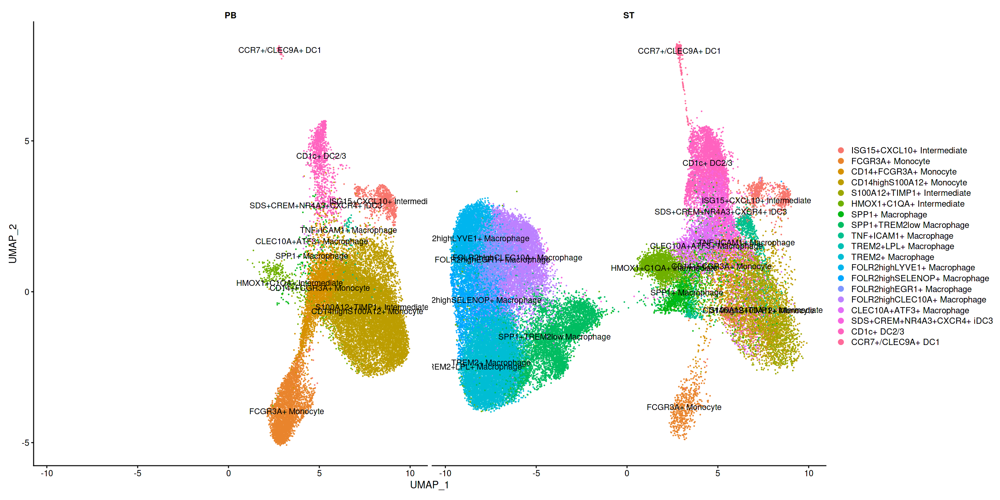

In [76]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

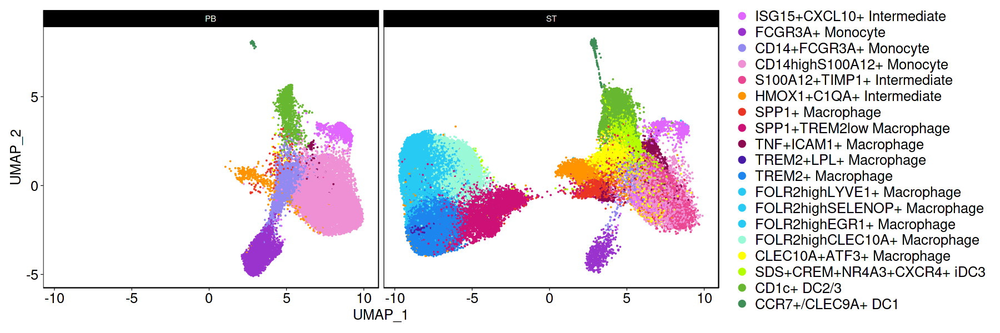

In [82]:
options(repr.plot.width=15, repr.plot.height=5)
DimPlot(myeloid, cols=cols, group.by="clusters", split.by="Tissue") + theme_specific + theme(plot.title=element_blank(),legend.text=element_text(size=15))

In [35]:
DefaultAssay(myeloid) <- "RNA"

In [36]:
#Run UMAP and clustering 
myeloid <- FindNeighbors(object = myeloid, reduction = "harmony", dims = 1:40)
myeloid <- FindClusters(myeloid, res=0.8)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 70471
Number of edges: 2236091

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8600
Number of communities: 21
Elapsed time: 47 seconds


5 singletons identified. 16 final clusters.



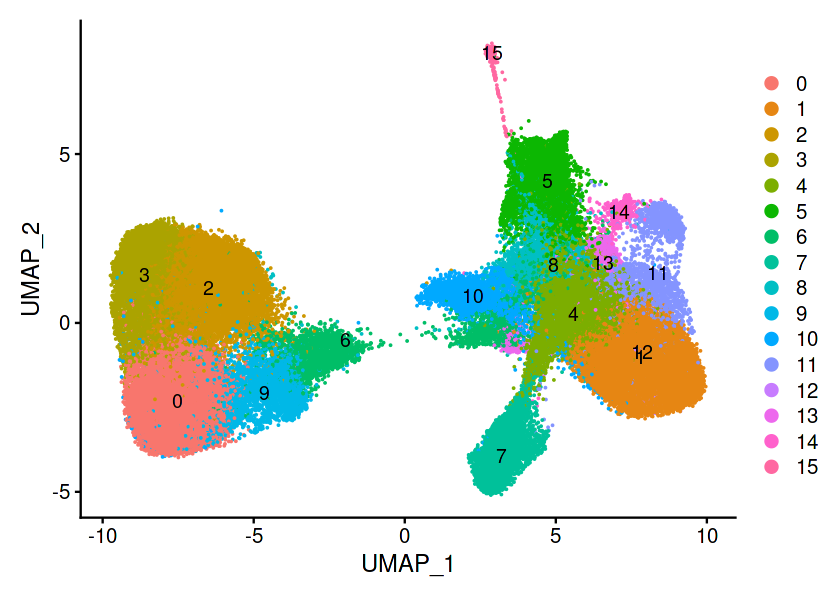

In [37]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(myeloid, label=TRUE)

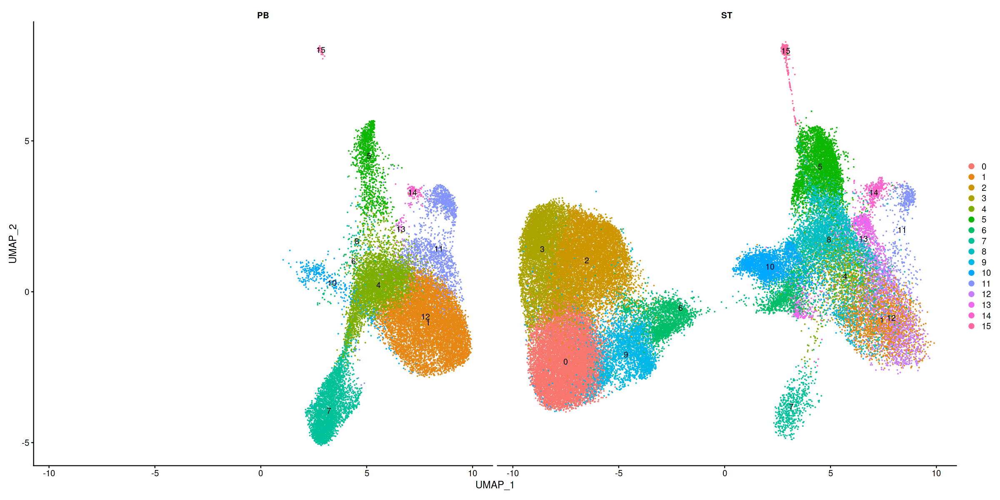

In [38]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(myeloid, label=TRUE, split.by="Tissue")

In [42]:
table(myeloid$seurat_clusters,myeloid$Tissue)

    
        PB    ST
  0      0 10625
  1   8136  2004
  2      0  9368
  3      0  6218
  4   4614  1015
  5   1154  3859
  6    113  3799
  7   3370   527
  8     45  3840
  9      0  3208
  10   402  2684
  11  1744   607
  12     4  1283
  13    49   954
  14   109   405
  15    28   307

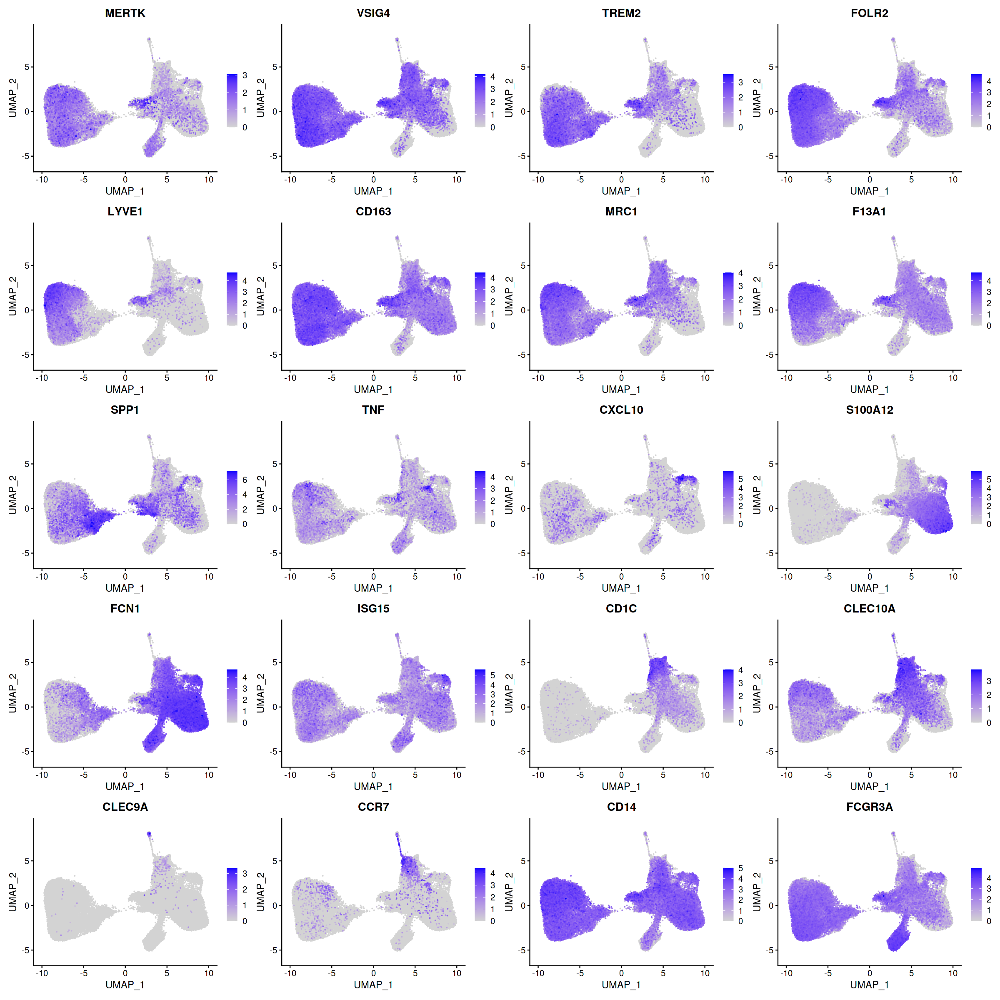

In [45]:
genes=c("MERTK","VSIG4","TREM2","FOLR2","LYVE1","CD163","MRC1","F13A1","SPP1","TNF","CXCL10","S100A12","FCN1","ISG15","CD1C","CLEC10A","CLEC9A","CCR7","CD14","FCGR3A")
options(repr.plot.width=20, repr.plot.height=20)
FeaturePlot(myeloid, features = unique(genes),order=TRUE)

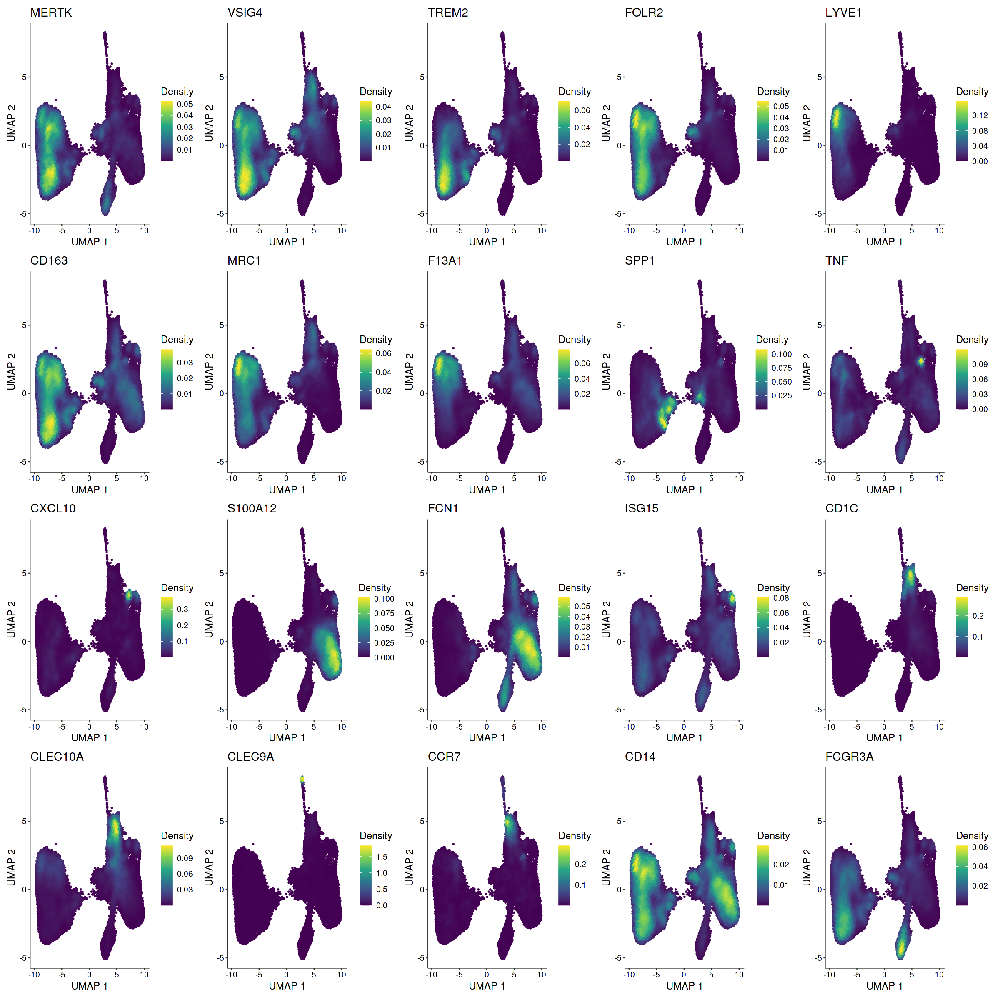

In [46]:
options(repr.plot.width=20, repr.plot.height=20)
plot_density(myeloid, features=genes, reduction="umap")

In [47]:
myeloid.subset <- subset(myeloid, downsample = 500)

In [48]:
myeloid.subset

An object of class Seurat 
19143 features across 7835 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

In [49]:
cluster.markers <- FindAllMarkers(myeloid.subset, only.pos=TRUE, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====

In [50]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

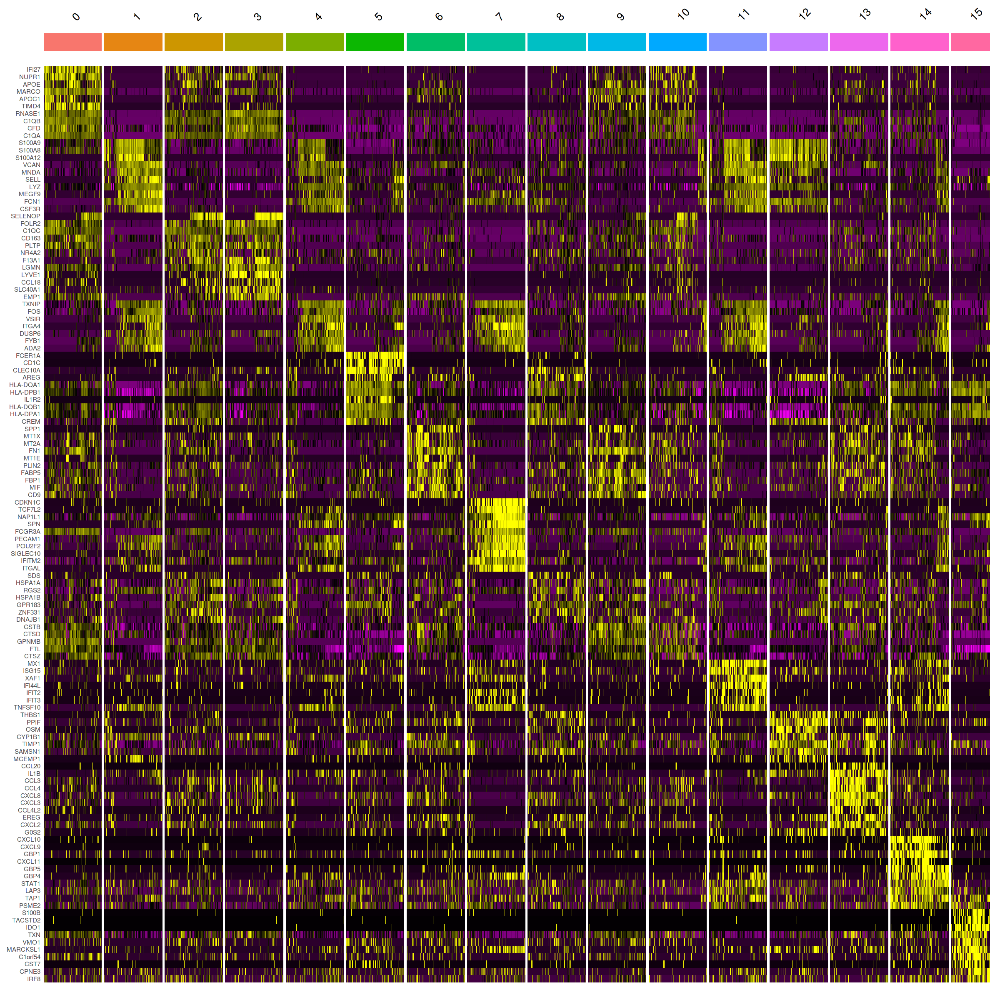

In [51]:
options(repr.plot.width=20, repr.plot.height=20)
DoHeatmap(myeloid.subset, features=unique(top10$gene)) + NoLegend()

In [61]:
top10[top10$cluster=="14",]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,4.724817,0.730,0.040,0.000000e+00,14,CXCL10
5.330945e-165,2.943212,0.466,0.041,1.020503e-160,14,CXCL9
0.000000e+00,2.810501,0.874,0.208,0.000000e+00,14,GBP1
3.229654e-229,2.280426,0.472,0.014,6.182526e-225,14,CXCL11
3.938383e-262,1.989372,0.734,0.102,7.539247e-258,14,GBP5
4.170017e-178,1.520739,0.684,0.150,7.982664e-174,14,GBP4
7.047563e-157,1.416624,0.818,0.342,1.349115e-152,14,STAT1
4.239552e-185,1.404929,0.882,0.509,8.115774e-181,14,LAP3
6.463424e-141,1.338884,0.748,0.258,1.237293e-136,14,TAP1


In [139]:
Idents(myeloid) <- "seurat_clusters"
FOLR2pos <- subset(myeloid,idents='2')

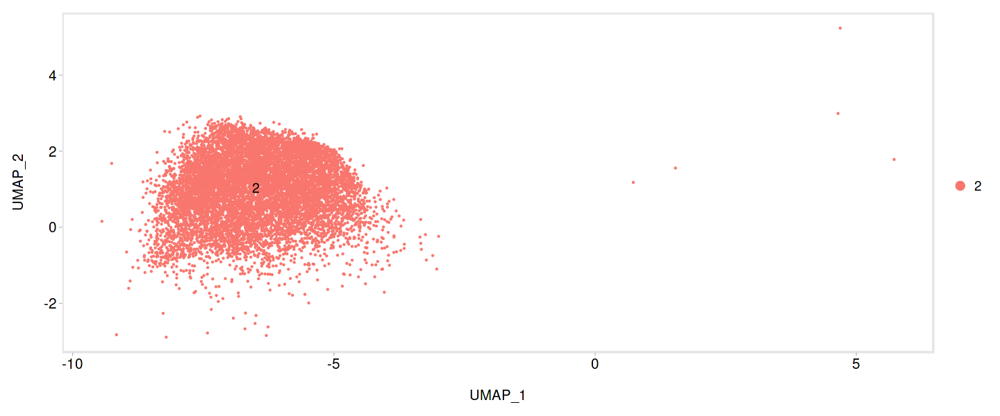

In [140]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(FOLR2pos, label=TRUE) + theme_powerpoint()

In [153]:
#Run UMAP and clustering 
FOLR2pos <- FindNeighbors(object = FOLR2pos, reduction = "harmony", dims = 1:20)
FOLR2pos <- FindClusters(FOLR2pos, res=0.3)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 9368
Number of edges: 271380

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7944
Number of communities: 4
Elapsed time: 3 seconds


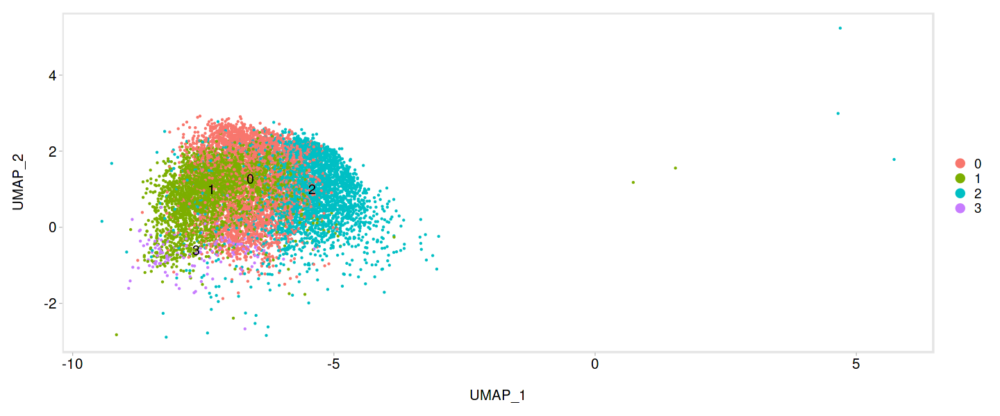

In [154]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(FOLR2pos, label=TRUE) + theme_powerpoint()

In [155]:
cluster.markers <- FindAllMarkers(FOLR2pos, only.pos=TRUE,  min.pct=0.4, test.use="MAST")
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster 0


 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  11% with 0 failures

 Completed [====>---------------------------------------]  12% with 0 failures

 Completed [=====>--------------------------------------]  13% with 0 failures

 Completed [=====>--------------------------------------]  14% with 0 failures

 Completed [======>-------------------------------------]  15% with 0 failures

 Completed [======>-------------------------------------]  16% with 0 failures

 Completed [======>-------------------------------------]  17% with 0 failures

 Completed [=======>------------------------------------]  17% with 0 failures

 Completed [====

In [156]:
cluster.markers

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
F13A1,9.078813e-157,0.8646743,0.736,0.626,1.737957e-152,0,F13A1
THBD,6.516291e-144,0.9168861,0.662,0.472,1.247414e-139,0,THBD
FNIP2,3.487519e-117,0.7032760,0.713,0.535,6.676158e-113,0,FNIP2
MT-ND1,9.704755e-102,0.4875247,0.992,0.981,1.857781e-97,0,MT-ND1
CTSL,6.781171e-98,0.4882173,0.943,0.891,1.298120e-93,0,CTSL
STAB1,2.928002e-97,0.5509550,0.785,0.686,5.605075e-93,0,STAB1
MT-ND2,3.496058e-97,0.4744487,0.997,0.985,6.692504e-93,0,MT-ND2
DAB2,9.002110e-95,0.4583229,0.838,0.735,1.723274e-90,0,DAB2
A2M,4.943170e-93,0.4842325,0.786,0.702,9.462710e-89,0,A2M


In [157]:
top10 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 10, order_by = avg_log2FC)

In [170]:
#Rename your clusters by celltype
Idents(FOLR2pos) <- "seurat_clusters"
FOLR2pos$subclusters <- plyr::revalue(as.character(Idents(FOLR2pos)),
                                        c("0"='FOLR2highSELENOP+ Macrophage',
                                         "1"='FOLR2highEGR1+ Macrophage',
                                         "2"='FOLR2highCLEC10A+ Macrophage',
                                         "3"='FOLR2highSELENOP+ Macrophage'))

                                         
Idents(FOLR2pos) <- "subclusters"

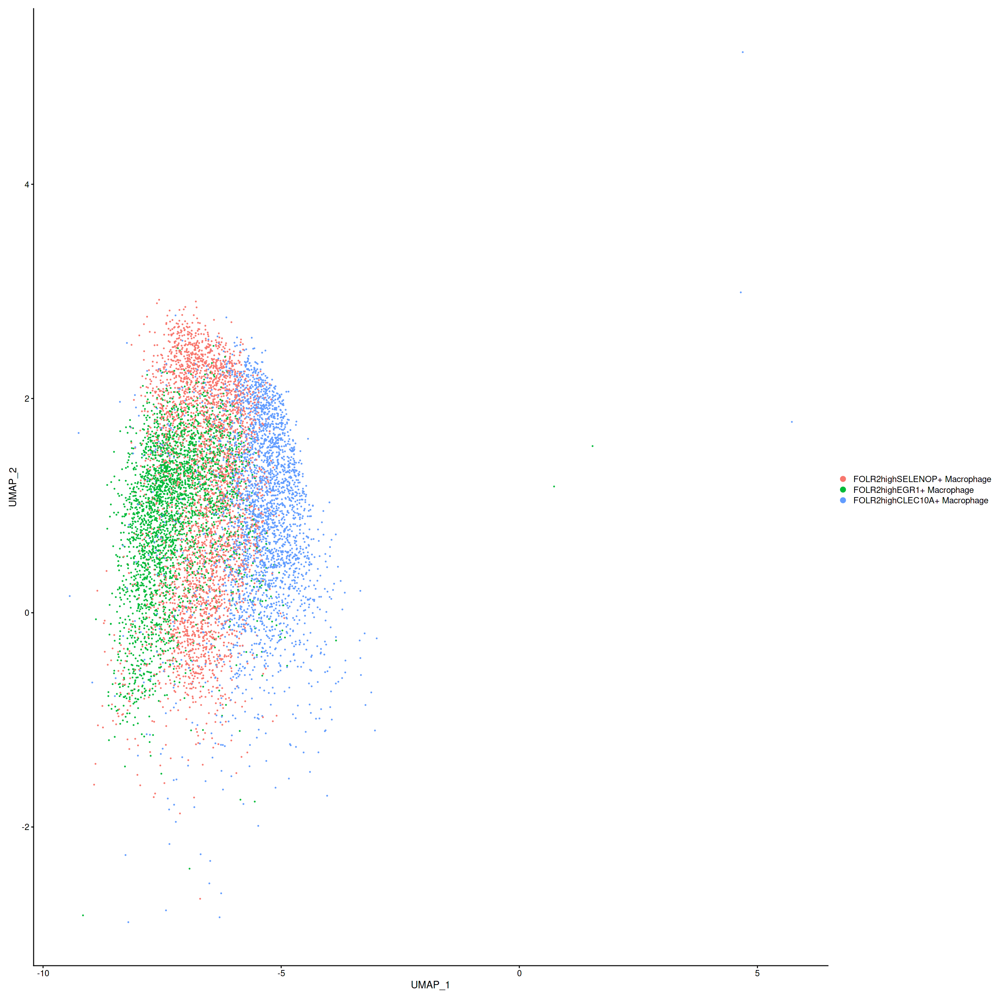

In [171]:
UMAPPlot(FOLR2pos)

In [173]:
#Pull metadata with new subclustering annotation for population of interest
folr2.anno = as.data.frame(FOLR2pos$subclusters)
colnames(folr2.anno) <- "subclusters"
folr2.anno$barcode<-rownames(folr2.anno)
head(folr2.anno)

,subclusters,barcode
,<chr>,<chr>
AAACCTGTCCGTAGTA-1_1_1,FOLR2highSELENOP+ Macrophage,AAACCTGTCCGTAGTA-1_1_1
AACACGTGTGACTCAT-1_1_1,FOLR2highSELENOP+ Macrophage,AACACGTGTGACTCAT-1_1_1
AACCATGGTCTCACCT-1_1_1,FOLR2highSELENOP+ Macrophage,AACCATGGTCTCACCT-1_1_1
AACGTTGCACTGTGTA-1_1_1,FOLR2highSELENOP+ Macrophage,AACGTTGCACTGTGTA-1_1_1
AACTCAGCACGGTAGA-1_1_1,FOLR2highEGR1+ Macrophage,AACTCAGCACGGTAGA-1_1_1
AACTCAGTCGGTGTCG-1_1_1,FOLR2highEGR1+ Macrophage,AACTCAGTCGGTGTCG-1_1_1


In [174]:
#Pull metadata from clustering of whole object
myeloid.anno = myeloid@meta.data
myeloid.anno$barcode<-rownames(myeloid.anno)
head(myeloid.anno)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.hb,percent.ribo,RNA_snn_res.0.1,seurat_clusters,pANN_0.25_0.09_3,Doublets.Low.Confidence,⋯,RNA_snn_res.1.2,RNA_snn_res.1,sample,integrated.clusters,integrated.pb.clusters,tissue_condition,all.myeloid.clusters,RNA_snn_res.0.8,clusters.res0.8,barcode
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<chr>,⋯,<chr>,<fct>,<chr>,<chr>,<ord>,<ord>,<fct>,<fct>,<ord>,<chr>
AAACCTGTCCGTAGTA-1_1_1,HC0547,3827.603,1224,5.445071,0.00000000,17.82018,0,2,0.12359551,Singlet,⋯,NA,3,NA,NA,NA,ST_Healthy,FOLR2highCLEC10A+ Macrophage,2,FOLR2highSELENOP+ Macrophage,AAACCTGTCCGTAGTA-1_1_1
AAACCTGTCTCTAGGA-1_1_1,HC0547,1516.173,716,6.237315,0.06389909,15.13201,0,10,0.05617978,Singlet,⋯,NA,16,NA,NA,NA,ST_Healthy,HMOX1+C1QA+ Macrophage,10,C1QAhighHMOX1+ Intermediate,AAACCTGTCTCTAGGA-1_1_1
AAAGATGGTTCGCTAA-1_1_1,HC0547,3338.378,1171,7.010303,0.02857726,16.32467,0,0,0.07865169,Singlet,⋯,NA,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AAAGATGGTTCGCTAA-1_1_1
AAAGATGTCGTGACAT-1_1_1,HC0547,5134.378,1411,6.603362,0.00000000,20.14081,0,3,0.16853933,Singlet,⋯,NA,5,NA,NA,NA,ST_Healthy,FOLR2highSELENOP+ Macrophage,3,FOLR2highLYVE1+ Macrophage,AAAGATGTCGTGACAT-1_1_1
AACACGTAGAGCTGGT-1_1_1,HC0547,8352.686,1796,3.847193,0.00000000,29.78424,5,5,0.24719101,Singlet,⋯,NA,4,NA,NA,NA,ST_Healthy,SDS+CREM+NR4A3+CXCR4+ iDC3,5,CD1c+ cDC,AACACGTAGAGCTGGT-1_1_1
AACACGTCAGGACGTA-1_1_1,HC0547,7097.315,1655,3.749419,0.00000000,14.97096,0,0,0.24719101,Singlet,⋯,NA,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AACACGTCAGGACGTA-1_1_1


In [175]:
myeloid.subclustered <- left_join(myeloid.anno, folr2.anno, by="barcode")
head(myeloid.subclustered)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.hb,percent.ribo,RNA_snn_res.0.1,seurat_clusters,pANN_0.25_0.09_3,Doublets.Low.Confidence,⋯,RNA_snn_res.1,sample,integrated.clusters,integrated.pb.clusters,tissue_condition,all.myeloid.clusters,RNA_snn_res.0.8,clusters.res0.8,barcode,subclusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<chr>,⋯,<fct>,<chr>,<chr>,<ord>,<ord>,<fct>,<fct>,<ord>,<chr>,<chr>
1,HC0547,3827.603,1224,5.445071,0.00000000,17.82018,0,2,0.12359551,Singlet,⋯,3,NA,NA,NA,ST_Healthy,FOLR2highCLEC10A+ Macrophage,2,FOLR2highSELENOP+ Macrophage,AAACCTGTCCGTAGTA-1_1_1,FOLR2highSELENOP+ Macrophage
2,HC0547,1516.173,716,6.237315,0.06389909,15.13201,0,10,0.05617978,Singlet,⋯,16,NA,NA,NA,ST_Healthy,HMOX1+C1QA+ Macrophage,10,C1QAhighHMOX1+ Intermediate,AAACCTGTCTCTAGGA-1_1_1,NA
3,HC0547,3338.378,1171,7.010303,0.02857726,16.32467,0,0,0.07865169,Singlet,⋯,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AAAGATGGTTCGCTAA-1_1_1,NA
4,HC0547,5134.378,1411,6.603362,0.00000000,20.14081,0,3,0.16853933,Singlet,⋯,5,NA,NA,NA,ST_Healthy,FOLR2highSELENOP+ Macrophage,3,FOLR2highLYVE1+ Macrophage,AAAGATGTCGTGACAT-1_1_1,NA
5,HC0547,8352.686,1796,3.847193,0.00000000,29.78424,5,5,0.24719101,Singlet,⋯,4,NA,NA,NA,ST_Healthy,SDS+CREM+NR4A3+CXCR4+ iDC3,5,CD1c+ cDC,AACACGTAGAGCTGGT-1_1_1,NA
6,HC0547,7097.315,1655,3.749419,0.00000000,14.97096,0,0,0.24719101,Singlet,⋯,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AACACGTCAGGACGTA-1_1_1,NA


In [184]:
#Combine cluster annotation column giving priority to DC annotation
myeloid.subclustered$clusters <- ifelse(is.na(myeloid.subclustered$subclusters), as.character(myeloid.subclustered$clusters.res0.8), as.character(myeloid.subclustered$subclusters))
rownames(myeloid.subclustered) <- myeloid.subclustered$barcode
head(myeloid.subclustered)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.hb,percent.ribo,RNA_snn_res.0.1,seurat_clusters,pANN_0.25_0.09_3,Doublets.Low.Confidence,⋯,RNA_snn_res.1,sample,integrated.clusters,integrated.pb.clusters,tissue_condition,all.myeloid.clusters,RNA_snn_res.0.8,clusters.res0.8,barcode,subclusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<chr>,⋯,<fct>,<chr>,<chr>,<ord>,<ord>,<fct>,<fct>,<ord>,<chr>,<chr>
AAACCTGTCCGTAGTA-1_1_1,HC0547,3827.603,1224,5.445071,0.00000000,17.82018,0,2,0.12359551,Singlet,⋯,3,NA,NA,NA,ST_Healthy,FOLR2highCLEC10A+ Macrophage,2,FOLR2highSELENOP+ Macrophage,AAACCTGTCCGTAGTA-1_1_1,FOLR2highSELENOP+ Macrophage
AAACCTGTCTCTAGGA-1_1_1,HC0547,1516.173,716,6.237315,0.06389909,15.13201,0,10,0.05617978,Singlet,⋯,16,NA,NA,NA,ST_Healthy,HMOX1+C1QA+ Macrophage,10,C1QAhighHMOX1+ Intermediate,AAACCTGTCTCTAGGA-1_1_1,NA
AAAGATGGTTCGCTAA-1_1_1,HC0547,3338.378,1171,7.010303,0.02857726,16.32467,0,0,0.07865169,Singlet,⋯,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AAAGATGGTTCGCTAA-1_1_1,NA
AAAGATGTCGTGACAT-1_1_1,HC0547,5134.378,1411,6.603362,0.00000000,20.14081,0,3,0.16853933,Singlet,⋯,5,NA,NA,NA,ST_Healthy,FOLR2highSELENOP+ Macrophage,3,FOLR2highLYVE1+ Macrophage,AAAGATGTCGTGACAT-1_1_1,NA
AACACGTAGAGCTGGT-1_1_1,HC0547,8352.686,1796,3.847193,0.00000000,29.78424,5,5,0.24719101,Singlet,⋯,4,NA,NA,NA,ST_Healthy,SDS+CREM+NR4A3+CXCR4+ iDC3,5,CD1c+ cDC,AACACGTAGAGCTGGT-1_1_1,NA
AACACGTCAGGACGTA-1_1_1,HC0547,7097.315,1655,3.749419,0.00000000,14.97096,0,0,0.24719101,Singlet,⋯,0,NA,NA,NA,ST_Healthy,TREM2+ Macrophage,0,TREM2+ Macrophage,AACACGTCAGGACGTA-1_1_1,NA


In [185]:
myeloid@meta.data <- myeloid.subclustered

In [17]:
myeloid$clusters <- as.ordered(factor(myeloid$clusters, levels=c("FCGR3A+ Monocyte","CD14+FCGR3A+ Monocyte","CD14highS100A12+ Monocyte",
                                                                               "ISG15+ Intermediate",'CXCL10+STAT1+ Macrophage',"TNF+ICAM1+ Macrophage",'C1QAhighHMOX1+ Intermediate',
                                                                "SPP1+ Macrophage","SPP1+TREM2low Macrophage","TREM2+ Macrophage", "FOLR2highLYVE1+ Macrophage","FOLR2highSELENOP+ Macrophage",
                                                                               "FOLR2highEGR1+ Macrophage","FOLR2highCLEC10A+ Macrophage",
                                                               'SDS+NR4A3+CXCR4+ iDC3',"CD1c+ cDC","CCR7+/CLEC9A+ DC1")))
Idents(myeloid) <- "clusters"

In [18]:
levels(myeloid$clusters)

[1] "FCGR3A+ Monocyte"             "CD14+FCGR3A+ Monocyte"       
 [3] "CD14highS100A12+ Monocyte"    "ISG15+ Intermediate"         
 [5] "CXCL10+STAT1+ Macrophage"     "TNF+ICAM1+ Macrophage"       
 [7] "C1QAhighHMOX1+ Intermediate"  "SPP1+ Macrophage"            
 [9] "SPP1+TREM2low Macrophage"     "TREM2+ Macrophage"           
[11] "FOLR2highLYVE1+ Macrophage"   "FOLR2highSELENOP+ Macrophage"
[13] "FOLR2highEGR1+ Macrophage"    "FOLR2highCLEC10A+ Macrophage"
[15] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[17] "CCR7+/CLEC9A+ DC1"

In [33]:
cols <- c("darkorchid3","#938AF1",
                  "#EF90D4", "#EB4691","deeppink3","deeppink4","#FF9300",
      "#EA3424","#481BA7","dodgerblue2",   "#9aecfa", "#27CAF3","#27CAF3",
                       "#51F6BC","yellow", 
                  "#B4FF00","#68B731","darkgreen")

In [20]:
unique(myeloid$Experiment)

[1] "Oxford"    "Glasgow1"  "Glasgow2"  "Glasgow3"  "10X"       "Organoids"

In [3]:
#Rename your clusters by celltype
myeloid$Tissue <- plyr::revalue(as.character(myeloid$Tissue),
                                        c("PB"='Peripheral Blood (PB)', "ST"='Synovial Tissue (ST)'))

In [24]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(myeloid@meta.data),Embeddings(myeloid, reduction = "umap")[,1], Embeddings(myeloid, reduction = "umap")[,2],
                   myeloid$Tissue,myeloid$condition,myeloid$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(myeloid$clusters)))
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "FCGR3A+ Monocyte"             "CD14+FCGR3A+ Monocyte"       
 [3] "CD14highS100A12+ Monocyte"    "ISG15+ Intermediate"         
 [5] "CXCL10+STAT1+ Macrophage"     "TNF+ICAM1+ Macrophage"       
 [7] "C1QAhighHMOX1+ Intermediate"  "SPP1+ Macrophage"            
 [9] "SPP1+TREM2low Macrophage"     "TREM2+ Macrophage"           
[11] "FOLR2highLYVE1+ Macrophage"   "FOLR2highSELENOP+ Macrophage"
[13] "FOLR2highEGR1+ Macrophage"    "FOLR2highCLEC10A+ Macrophage"
[15] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[17] "CCR7+/CLEC9A+ DC1"

In [25]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

In [26]:
#Get co-ordinates for the cluster labels
plt_df <- umap %>%  group_by(color_col) %>% 
        mutate(x_mid = median(UMAP1), y_mid = median(UMAP2), label_col = color_col) %>% 
        ungroup() %>% sample_frac(1)
head(plt_df)

ID,UMAP1,UMAP2,facet_col,Group,color_col,x_mid,y_mid,label_col
<chr>,<dbl>,<dbl>,<chr>,<fct>,<ord>,<dbl>,<dbl>,<ord>
CAGAATCCAGTAGAGC-1_6_6,-8.080220,-0.8527526,Synovial Tissue (ST),Active RA,TREM2+ Macrophage,-7.514460,-2.3133302,TREM2+ Macrophage
TCCCAGTAGCAGCCTC-1_1_24,-7.351177,-2.4670363,Synovial Tissue (ST),Active RA,TREM2+ Macrophage,-7.514460,-2.3133302,TREM2+ Macrophage
GCAATCAAGGGTGTGT-1_7_23,-7.734059,-3.5479350,Synovial Tissue (ST),Active RA,TREM2+ Macrophage,-7.514460,-2.3133302,TREM2+ Macrophage
TTTACCATCTGGTCAA-1_3_26,3.110265,0.7394952,Synovial Tissue (ST),Active RA,SPP1+ Macrophage,-1.968173,-0.5167214,SPP1+ Macrophage
ACATCGAAGACAGCGT-1_1_24,-8.264512,-1.7202819,Synovial Tissue (ST),Active RA,TREM2+ Macrophage,-7.514460,-2.3133302,TREM2+ Macrophage
CAGCTGGAGAATAGGG-1_5_5,5.706975,-1.1847918,Synovial Tissue (ST),Active RA,CD14highS100A12+ Monocyte,7.801456,-0.9866182,CD14highS100A12+ Monocyte


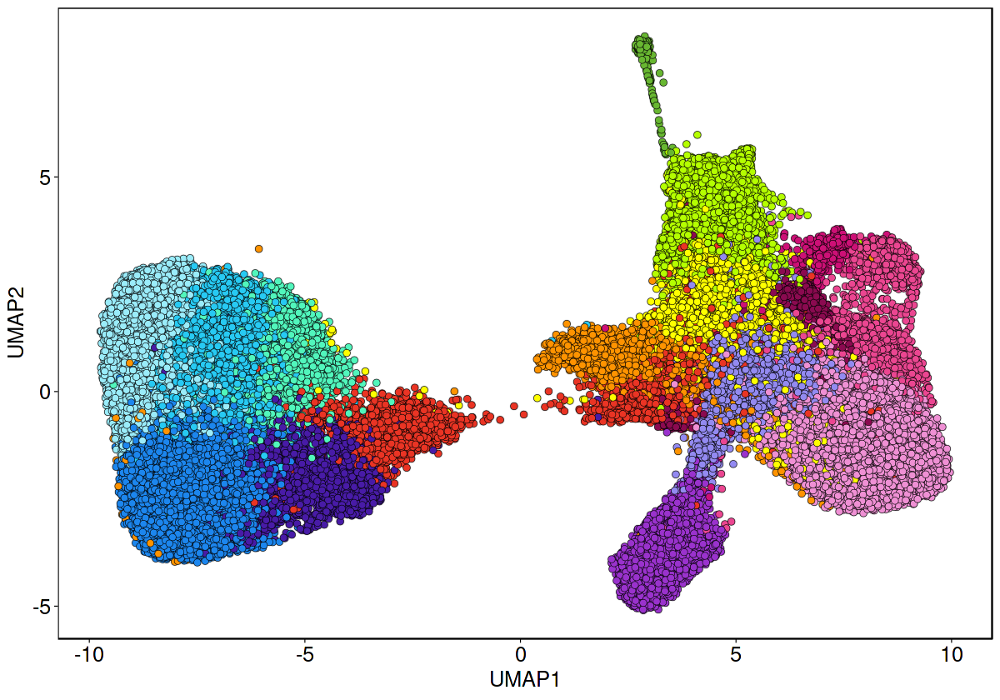

In [27]:
options(repr.plot.width=10, repr.plot.height=7)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=2, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=2, shape=21, stroke = 1/5) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

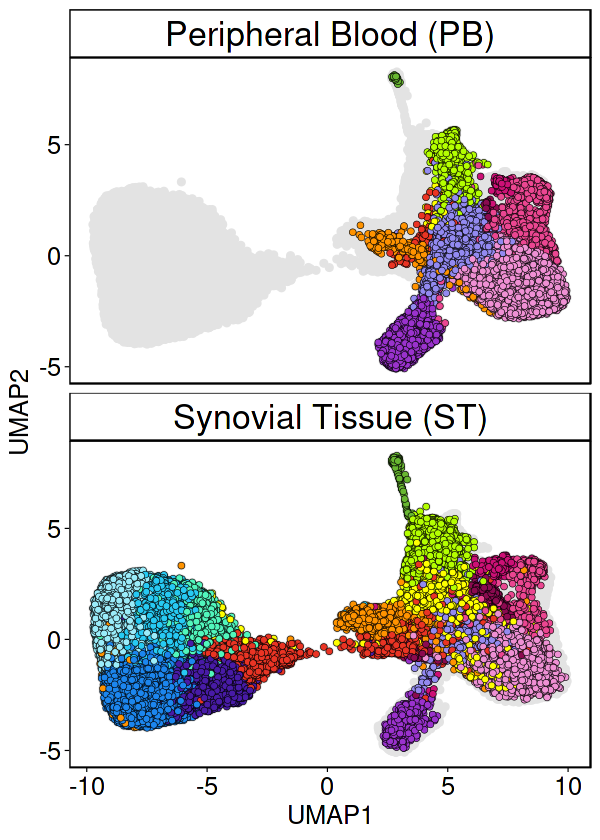

In [28]:
options(repr.plot.width=5, repr.plot.height=7)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=1.5, shape=21, stroke = 1/5) + facet_wrap(~facet_col, ncol=1) +
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

In [313]:
myeloid.st <- subset(myeloid, subset=Tissue=="ST")

In [30]:
Idents(myeloid) <- "clusters"

In [31]:
cluster.markers <- FindAllMarkers(myeloid, only.pos=TRUE,  min.pct=0.4, test.use="MAST")
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]
myeloid@misc <- cluster.markers

Calculating cluster FCGR3A+ Monocyte


 Completed [--------------------------------------------]   0% with 0 failures

 Completed [--------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   1% with 0 failures

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 

In [32]:
library(data.table)
# pick signficant genes to show in the heatmap
# arrange the genes such that the gene with max logFC is at the center and values decrease as we move away from center
genes_use_df<-data.table(cluster.markers)[
    p_val_adj < 0.05][
    , .SD[order(-avg_log2FC)][1:20, ], by = cluster][
    , .SD[!is.na(gene)]][
    , .SD[order(avg_log2FC)], by = cluster][
    , ":=" (len = .N, rank = frank(avg_log2FC)), by = cluster][
    , .SD[c(seq(1, round(.SD$len[1]/3), 1), seq(.SD$len[1], round(.SD$len[1]/3)+1, -1)), ], by = cluster][
    , .(gene, avg_log2FC, cluster, p_val_adj) 
]
#Organise genes we want to include by cluster
genes_use_df <- genes_use_df %>% distinct(gene, .keep_all = TRUE) %>% arrange(cluster)


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last




In [33]:
message("Checking that the genes are unique: ", nrow(genes_use_df) == length(unique(genes_use_df$gene)))
message("Number of genes in heatmap: ", nrow(genes_use_df))

# select the top 5 genes with highest logFC in each cluster and assign each gene to a cell type based on it logFC - the gene belongs to the celltype with higher logFC
genes_to_mark_celltypes<-genes_use_df[, .SD[order(-avg_log2FC)][1:3, ], by = cluster][
    , .(cluster, gene)
]

.mat<-cluster.markers %>% 
    subset(gene %in% genes_use_df$gene) %>% 
    dplyr::select(cluster, avg_log2FC, gene) %>% 
    tidyr::spread(cluster, avg_log2FC) %>% 
    tibble::column_to_rownames('gene') %>% 
    as.matrix() 
.mat<-.mat[genes_use_df$gene,]

message(
    "Are all genes that are being marked also present in the matrix?: ", 
    length(setdiff(genes_to_mark_celltypes$gene, colnames(.mat))) == 0
)

Checking that the genes are unique: TRUE

Number of genes in heatmap: 255

Are all genes that are being marked also present in the matrix?: FALSE



In [34]:
genes_idx<-data.frame(idx = which(rownames(.mat) %in% genes_to_mark_celltypes$gene)) %>% 
    mutate(gene = rownames(.mat)[idx])

In [35]:
#Get the exact position of genes we wish to annotate in the matrix
genes_to_mark_celltypes<-genes_to_mark_celltypes %>% left_join(unique(genes_idx), by = "gene") %>% arrange(cluster)

In [36]:
head(genes_to_mark_celltypes)

cluster,gene,idx
<fct>,<chr>,<int>
FCGR3A+ Monocyte,CDKN1C,8
FCGR3A+ Monocyte,TCF7L2,9
FCGR3A+ Monocyte,NAP1L1,10
CD14+FCGR3A+ Monocyte,FCN1,27
CD14+FCGR3A+ Monocyte,TXNIP,28
CD14+FCGR3A+ Monocyte,DUSP6,29


In [37]:
#Set all NA to 0 so appear white
.mat[is.na(.mat)] <- 0

In [38]:
library(ComplexHeatmap)

Loading required package: grid

ComplexHeatmap version 2.15.4
Bioconductor page: http://bioconductor.org/packages/ComplexHeatmap/
Github page: https://github.com/jokergoo/ComplexHeatmap
Documentation: http://jokergoo.github.io/ComplexHeatmap-reference

If you use it in published research, please cite either one:
- Gu, Z. Complex Heatmap Visualization. iMeta 2022.
- Gu, Z. Complex heatmaps reveal patterns and correlations in multidimensional 
    genomic data. Bioinformatics 2016.


The new InteractiveComplexHeatmap package can directly export static 
complex heatmaps into an interactive Shiny app with zero effort. Have a try!

This message can be suppressed by:
  suppressPackageStartupMessages(library(ComplexHeatmap))
! pheatmap() has been masked by ComplexHeatmap::pheatmap(). Most of the arguments
   in the original pheatmap() are identically supported in the new function. You 
   can still use the original function by explicitly calling pheatmap::pheatmap().



Attaching package: ‘Co

In [18]:
clust.cols <- c("darkorchid3","#938AF1",
                  "#EF90D4", "#EB4691","deeppink3","deeppink4","#FF9300",
      "#EA3424","#481BA7","dodgerblue2",   "#9aecfa", "#27CAF3","#27CAF3",
                       "#51F6BC","yellow", 
                  "#B4FF00","#68B731","darkgreen")

In [19]:
names(clust.cols) <- levels(myeloid$clusters)

In [20]:
clust.cols

FCGR3A+ Monocyte        CD14+FCGR3A+ Monocyte 
               "darkorchid3"                    "#938AF1" 
   CD14highS100A12+ Monocyte          ISG15+ Intermediate 
                   "#EF90D4"                    "#EB4691" 
    CXCL10+STAT1+ Macrophage        TNF+ICAM1+ Macrophage 
                 "deeppink3"                  "deeppink4" 
 C1QAhighHMOX1+ Intermediate             SPP1+ Macrophage 
                   "#FF9300"                    "#EA3424" 
    SPP1+TREM2low Macrophage            TREM2+ Macrophage 
                   "#481BA7"                "dodgerblue2" 
  FOLR2highLYVE1+ Macrophage FOLR2highSELENOP+ Macrophage 
                   "#9aecfa"                    "#27CAF3" 
   FOLR2highEGR1+ Macrophage FOLR2highCLEC10A+ Macrophage 
                   "#27CAF3"                    "#51F6BC" 
       SDS+NR4A3+CXCR4+ iDC3                    CD1c+ cDC 
                    "yellow"                    "#B4FF00" 
           CCR7+/CLEC9A+ DC1                         <NA> 
                   "#68B731"                  "darkgreen"

In [21]:
options(repr.plot.width=10, repr.plot.height=10)
gene.anno<-rowAnnotation(
    row_ann = anno_mark(
        at = genes_to_mark_celltypes$idx,
        side = "right",
        labels = genes_to_mark_celltypes$gene)
    )
clust.anno<-columnAnnotation(show_legend = TRUE,
    cluster = genes_use_df$cluster,
    col = list(cluster=c(FCGR3A+ Monocyte
    'darkorchid3'
CD14+FCGR3A+ Monocyte
    '#938AF1'
CD14highS100A12+ Monocyte
    '#EF90D4'
ISG15+ Intermediate
    '#EB4691'
CXCL10+STAT1+ Macrophage
    'deeppink3'
TNF+ICAM1+ Macrophage
    'deeppink4'
C1QAhighHMOX1+ Intermediate
    '#FF9300'
SPP1+ Macrophage
    '#EA3424'
SPP1+TREM2low Macrophage
    '#481BA7'
TREM2+ Macrophage
    'dodgerblue2'
FOLR2highLYVE1+ Macrophage
    '#9aecfa'
FOLR2highSELENOP+ Macrophage
    '#27CAF3'
FOLR2highEGR1+ Macrophage
    '#27CAF3'
FOLR2highCLEC10A+ Macrophage
    '#51F6BC'
SDS+NR4A3+CXCR4+ iDC3
    'yellow'
CD1c+ cDC
    '#B4FF00'
CCR7+/CLEC9A+ DC1
    '#68B731'
'darkgreen'))
    )
#ha2<-columnAnnotation(
#     celltypes = anno_block(
#         gp = gpar(fill = col_pal), 
#         labels = genes_use_df$contrast %>% unique

# ))
split<-unique(genes_use_df$cluster)
rownames(.mat)<-NULL
colnames(.mat)<- NULL
.mat %>% 
    Heatmap(
        name = 'avg_log2FC',
        col = circlize::colorRamp2(c(0, 0.1, 2), c('white', 'white', muted('blue'))),
        #column_names_gp = grid::gpar(fontsize = 10),
#         row_dend_side = "right",
        cluster_rows = FALSE,
        cluster_columns = FALSE,
        top_annotation = clust.anno, 
       right_annotation = gene.anno)

ERROR: Error in parse(text = x, srcfile = src): <text>:11:5: unexpected string constant
10:     col = list(cluster=c(FCGR3A+ Monocyte
11:     'darkorchid3'
        ^


In [ ]:
write.csv(cluster.markers, "myeloid_pb_st_cluster.markers.csv")

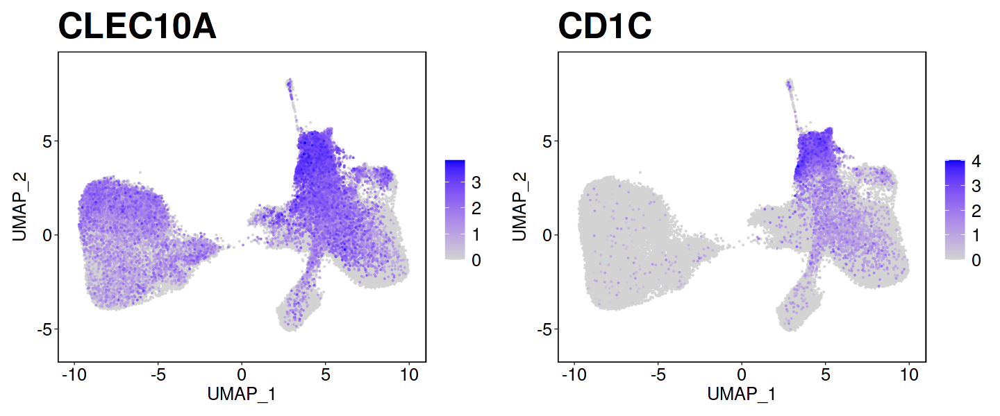

In [63]:
options(repr.plot.width=12, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(myeloid, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)


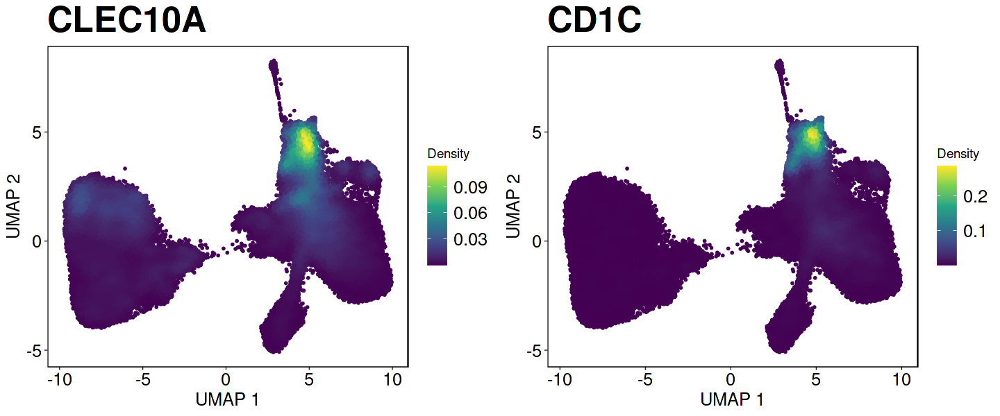

In [64]:
options(repr.plot.width=12, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(myeloid, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15))  }

plot_grid(plotlist=x, ncol=2)


In [265]:
saveRDS(myeloid, "./cache/renamed.myeloid.rds")

In [2]:
myeloid <- readRDS("./cache/renamed.myeloid.rds")

In [3]:
myeloid

An object of class Seurat 
19143 features across 70471 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

## Visualize CITEseq expression on Glasgow 3 data

In [57]:
glasgow3 <- subset(myeloid, subset=Experiment=="Glasgow3")
glasgow3

An object of class Seurat 
19143 features across 11338 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

In [58]:
glasgow3orig <- readRDS("/datastore/MKS_Data/UNpublished/DC_paper_Immunity/Immunity_Oxford+Glasgow1-3.rds")
glasgow3orig <- subset(glasgow3orig, subset=Experiment=="Glasgow3")
glasgow3orig <- subset(glasgow3orig, cells = Cells(glasgow3))

In [59]:
glasgow3[["ADT"]] <- CreateAssayObject(data=glasgow3orig@assays$ADT@data)

In [60]:
saveRDS(glasgow3, "./cache/renamed.myeloid.glasgow3citeseq.rds")

In [61]:
rownames(glasgow3@assays$ADT)

[1] "Hu.CD86"            "Hu.CD274"           "Hu.CD270"          
  [4] "Hu.CD155"           "Hu.CD112"           "Hu.CD47"           
  [7] "Hu.CD48"            "Hu.CD40"            "Hu.CD154"          
 [10] "Hu.CD52"            "Hu.CD3-UCHT1"       "Hu.CD8"            
 [13] "Hu.CD56"            "Hu.CD19"            "Hu.CD33"           
 [16] "Hu.CD11c"           "Hu.HLA.ABC"         "Hu.CD45RA"         
 [19] "Hu.CD123"           "Hu.CD7"             "HuMs.CD49f"        
 [22] "Hu.CD194"           "Hu.CD4-RPA.T4"      "HuMs.CD44"         
 [25] "Hu.CD14-M5E2"       "Hu.CD16"            "Hu.CD25"           
 [28] "Hu.CD45RO"          "Hu.CD279"           "Hu.TIGIT"          
 [31] "Isotype-MOPC.21"    "Isotype-MOPC.173"   "Isotype-MPC.11"    
 [34] "Isotype-RTK4530"    "Hu.CD20-2H7"        "Hu.CD335"          
 [37] "Hu.CD31"            "Hu.Podoplanin"      "Hu.CD146"          
 [40] "Hu.IgM"             "Hu.CD5"             "Hu.CD183"          
 [43] "Hu.CD195"           "Hu.CD32"            "Hu.CD196"          
 [46] "Hu.CD185"           "Hu.CD103"           "Hu.CD69"           
 [49] "Hu.CD62L"           "Hu.CD161"           "Hu.CD152"          
 [52] "Hu.CD223"           "Hu.KLRG1"           "Hu.CD27"           
 [55] "Hu.CD107a"          "Hu.CD95"            "Hu.CD134"          
 [58] "Hu.HLA.DR"          "Hu.CD1c"            "Hu.CD11b"          
 [61] "Hu.CD64"            "Hu.CD141"           "Hu.CD314"          
 [64] "Hu.CD35"            "Hu.CD57"            "Hu.CD272"          
 [67] "HuMsRt.CD278"       "Hu.CD275-B7.RP1"    "Hu.CD58"           
 [70] "Hu.CD39"            "Hu.CX3CR1"          "Hu.CD24"           
 [73] "Hu.CD21"            "Hu.CD11a"           "Hu.CD79b"          
 [76] "Hu.CD244"           "Hu.CD169"           "HuMs.integrin.b7"  
 [79] "Hu.CD268"           "Hu.CD42b"           "Hu.CD54"           
 [82] "Hu.CD62P"           "Hu.CD119"           "Hu.TCR.AB"         
 [85] "Isotype-RTK2071"    "Isotype-G0114F7"    "Isotype-RTK2758"   
 [88] "Isotype-RTK4174"    "Isotype-HTK888"     "Hu.CD192"          
 [91] "Hu.CD122"           "Hu.CD267"           "Hu.FceRIa"         
 [94] "Hu.CD41"            "Hu.CD137"           "Hu.CD43"           
 [97] "Hu.CD163"           "Hu.CD83"            "Hu.CD13"           
[100] "Hu.CD2"             "Hu.CD226-11A8"      "Hu.CD29"           
[103] "Hu.CD303"           "Hu.CD49b"           "Hu.CD61"           
[106] "Hu.CD81"            "Hu.CD55"            "Hu.IgD"            
[109] "Hu.CD18"            "Hu.CD28"            "Hu.CD38-HIT2"      
[112] "Hu.CD127"           "Hu.CD45-HI30"       "Hu.CD22"           
[115] "Hu.CD71"            "Hu.CD26"            "Hu.CD115"          
[118] "Hu.CD63"            "Hu.CD304"           "Hu.CD36"           
[121] "Hu.CD172a"          "Hu.CD72"            "Hu.CD158"          
[124] "Hu.CD93"            "Hu.CD200"           "Hu.CD49a"          
[127] "Hu.CD49d"           "Hu.CD73"            "Hu.CD9"            
[130] "Hu.TCR.Va7.2"       "Hu.TCR.Vd2"         "Hu.CD354"          
[133] "Hu.CD305-LAIR1"     "Hu.LOX.1"           "Hu.CD158e1"        
[136] "Hu.CD109"           "Hu.CD142"           "Hu.CD319"          
[139] "Hu.CD99"            "Hu.CLEC12A"         "Hu.CD151"          
[142] "Hu.CD352"           "Hu.CLEC1B"          "Hu.CD94"           
[145] "Hu.IgE"             "Hu.CD150"           "Hu.CD162"          
[148] "Hu.CD84"            "Hu.Ig.LightChain.k" "Hu.CD85j"          
[151] "Hu.CD23"            "Hu.Ig.LightChain.l" "Hu.CD328"          
[154] "Hu.GPR56"           "Hu.CD82"            "Hu.NKp80"          
[157] "Hu.CD131"           "Hu.CD74"            "Hu.CD116"          
[160] "Hu.CD37"            "Hu.CD101"           "Hu.HLA.DR.DP.DQ"   
[163] "Hu.CD88"

In [62]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(glasgow3@meta.data),Embeddings(glasgow3, reduction = "umap")[,1], Embeddings(glasgow3, reduction = "umap")[,2],
                   glasgow3$Tissue,glasgow3$condition,glasgow3$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "Tissue", "Group", "Cluster")

#Save
write.csv(umap, "single.cell-umap.plot.csv")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")

In [63]:
umap$Cluster <- as.ordered(factor(umap$Cluster, levels=levels(glasgow3$clusters)))
umap <- umap[order(umap$Cluster),]

In [64]:
levels(umap$Cluster)

[1] "FCGR3A+ Monocyte"             "CD14+FCGR3A+ Monocyte"       
 [3] "CD14highS100A12+ Monocyte"    "ISG15+ Intermediate"         
 [5] "CXCL10+STAT1+ Macrophage"     "TNF+ICAM1+ Macrophage"       
 [7] "C1QAhighHMOX1+ Intermediate"  "SPP1+ Macrophage"            
 [9] "SPP1+TREM2low Macrophage"     "TREM2+ Macrophage"           
[11] "FOLR2highLYVE1+ Macrophage"   "FOLR2highSELENOP+ Macrophage"
[13] "FOLR2highEGR1+ Macrophage"    "FOLR2highCLEC10A+ Macrophage"
[15] "SDS+NR4A3+CXCR4+ iDC3"        "CD1c+ cDC"                   
[17] "CCR7+/CLEC9A+ DC1"

In [65]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15))

In [66]:
umap <- umap[order(umap$ID),]

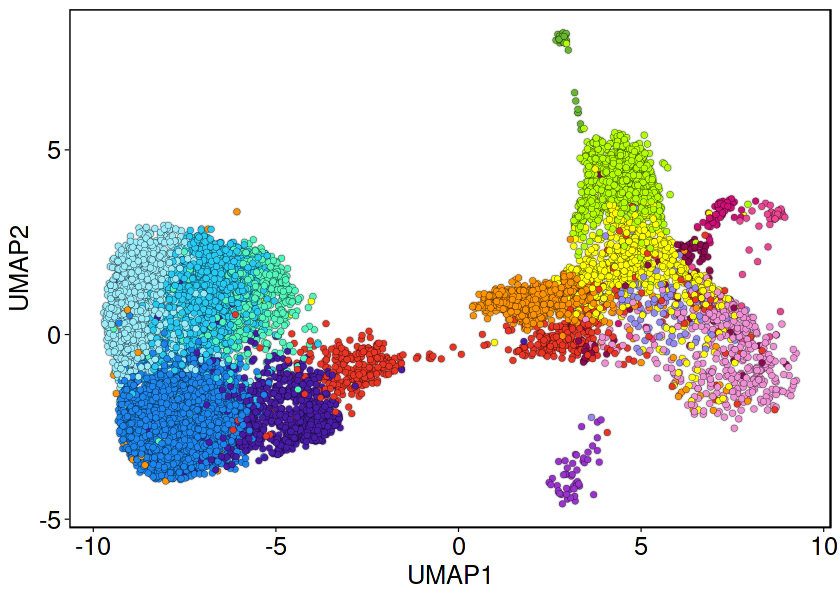

In [67]:
options(repr.plot.width=7, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(aes(fill=factor(Cluster)),color="black", size=1.5, shape=21, stroke = 1/10) + 
  scale_fill_manual(name=NULL, labels = levels(umap$Cluster), guide="legend", values=cols) + theme_specific + guides(fill=FALSE)

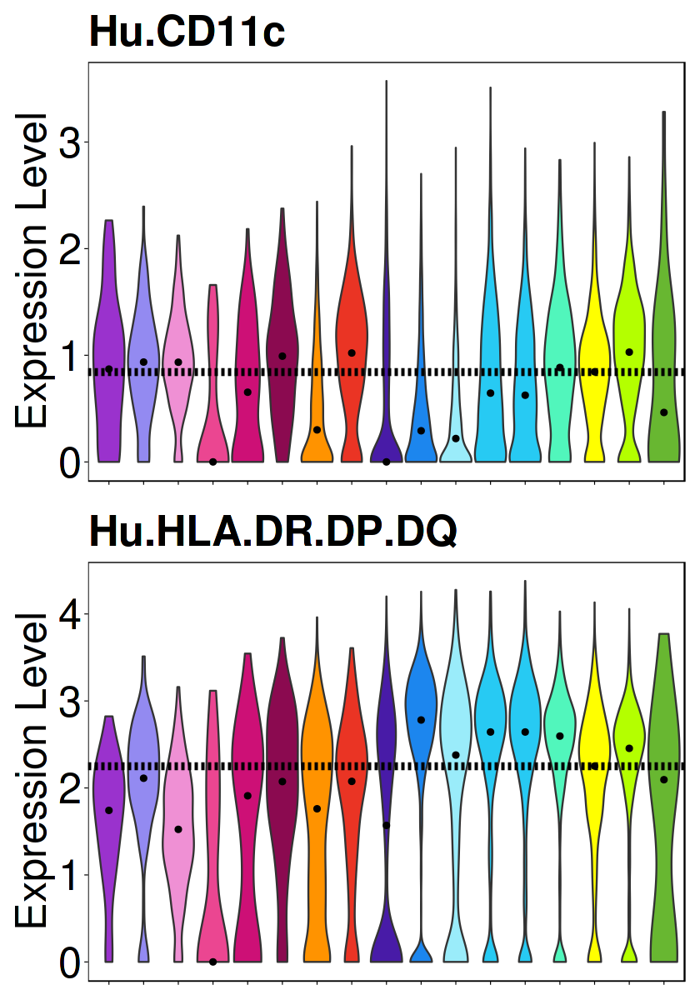

In [135]:
options(epr.plot.width=3, repr.plot.height=10)
x <- list()
DefaultAssay(glasgow3) <- "ADT"
for(protein in c("Hu.CD11c","Hu.HLA.DR.DP.DQ")){
    median <- median(glasgow3@assays$ADT@data[protein,glasgow3$clusters%in%c("SDS+NR4A3+CXCR4+ iDC3")])
  x[[paste0(protein,"1")]] <- VlnPlot(glasgow3, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) + NoLegend() + geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
}
plot_grid(plotlist=x, ncol=1)

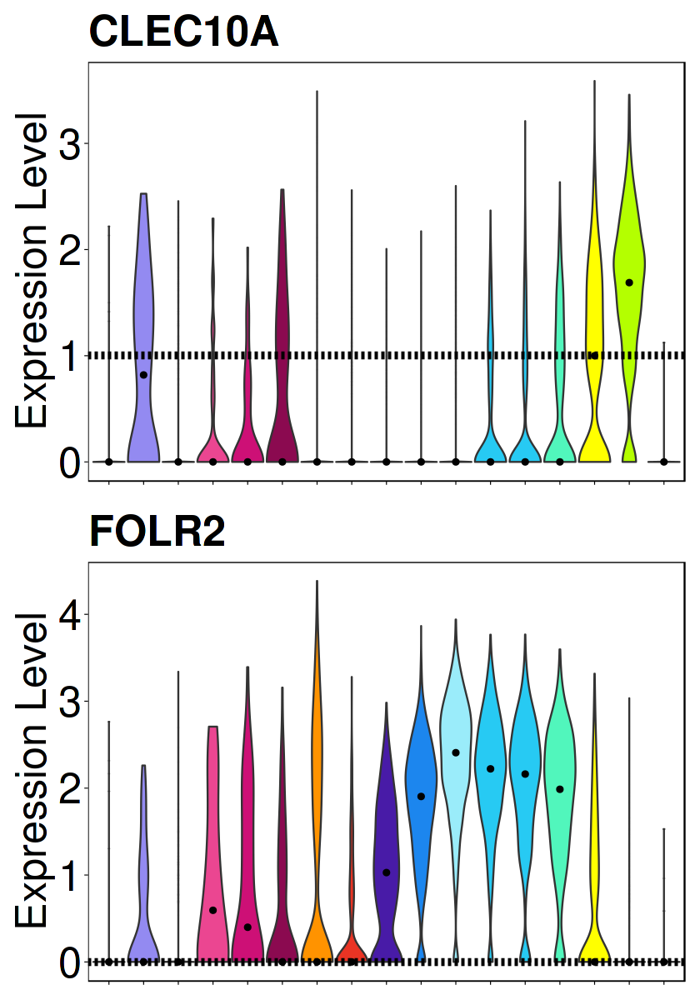

In [136]:
options(epr.plot.width=3, repr.plot.height=10)
x <- list()
DefaultAssay(glasgow3) <- "RNA"
for(gene in c("CLEC10A","FOLR2")){
    median <- median(glasgow3@assays$RNA@data[gene,glasgow3$clusters%in%c("SDS+NR4A3+CXCR4+ iDC3")])
  x[[paste0(gene,"1")]] <- VlnPlot(glasgow3, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) + NoLegend() + geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
}
plot_grid(plotlist=x, ncol=1)

## Isolate FOLR2 negative clusters

In [137]:
glasgow3.FOLR2neg <- subset(glasgow3, idents=c('SPP1+TREM2low Macrophage','TREM2+ Macrophage',
                                               'FOLR2highLYVE1+ Macrophage','FOLR2highSELENOP+ Macrophage',
                                               'FOLR2highEGR1+ Macrophage','FOLR2highCLEC10A+ Macrophage'), invert=TRUE)


In [138]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(glasgow3.FOLR2neg@meta.data),Embeddings(glasgow3.FOLR2neg, reduction = "umap")[,1], Embeddings(glasgow3.FOLR2neg, reduction = "umap")[,2],
                   glasgow3.FOLR2neg$Tissue,glasgow3.FOLR2neg$condition,glasgow3.FOLR2neg$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "Tissue", "Group", "Cluster")

#Save
write.csv(umap, "single.cell-umap.plot.csv")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")

In [139]:
umap$Cluster <- as.ordered(factor(umap$Cluster, levels=levels(glasgow3.FOLR2neg$clusters)))
umap <- umap[order(umap$Cluster),]

In [140]:
levels(umap$Cluster)

[1] "FCGR3A+ Monocyte"            "CD14+FCGR3A+ Monocyte"      
 [3] "CD14highS100A12+ Monocyte"   "ISG15+ Intermediate"        
 [5] "CXCL10+STAT1+ Macrophage"    "TNF+ICAM1+ Macrophage"      
 [7] "C1QAhighHMOX1+ Intermediate" "SPP1+ Macrophage"           
 [9] "SDS+NR4A3+CXCR4+ iDC3"       "CD1c+ cDC"                  
[11] "CCR7+/CLEC9A+ DC1"

In [141]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15))

In [142]:
names(cols) <- levels(glasgow3.FOLR2neg$clusters)

In [143]:
umap <- umap[order(umap$ID),]

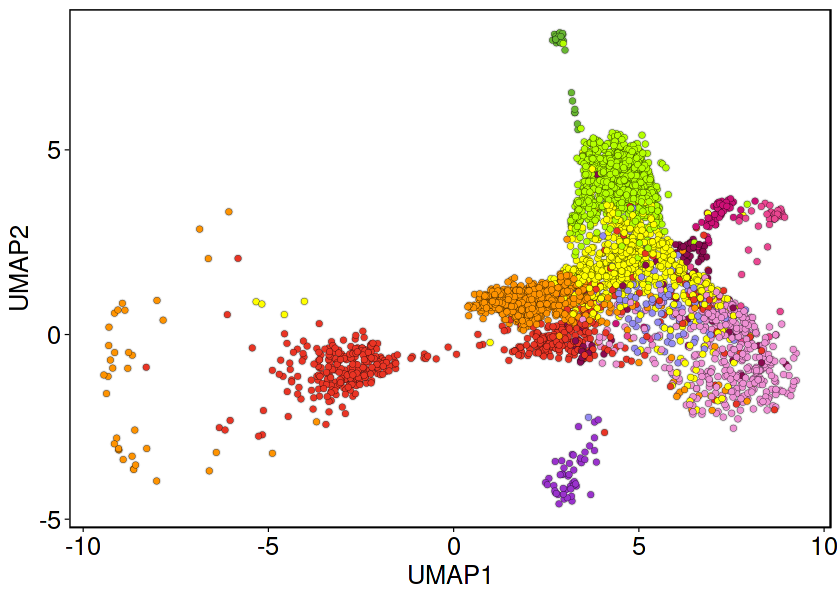

In [144]:
options(repr.plot.width=7, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(aes(fill=factor(Cluster)),color="black", size=1.5, shape=21, stroke = 1/10) + 
  scale_fill_manual(name=NULL, labels = levels(umap$Cluster), guide="legend", values=cols) + theme_specific + guides(fill=FALSE)

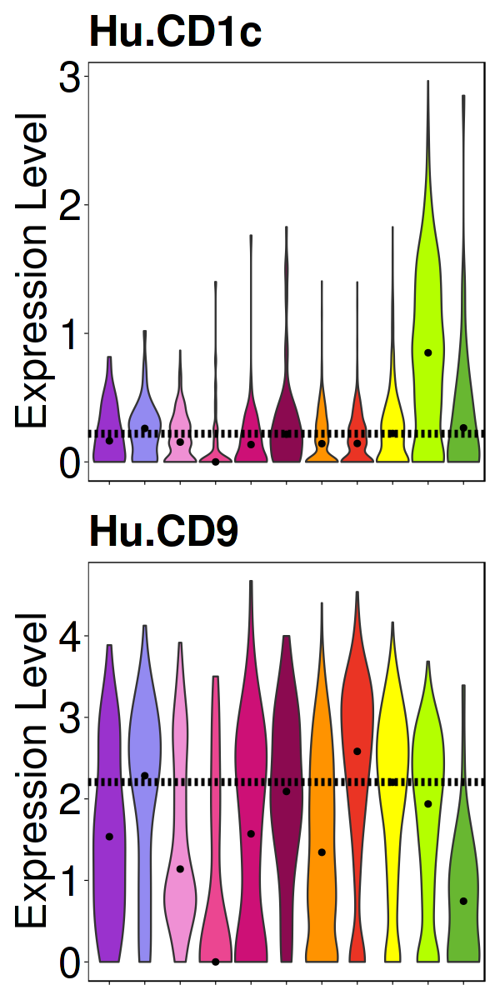

In [156]:
options(repr.plot.width=5, repr.plot.height=10)
x <- list()
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
for(protein in c("Hu.CD1c","Hu.CD9")){
  median <- median(glasgow3.FOLR2neg@assays$ADT@data[protein,glasgow3.FOLR2neg$clusters%in%c("SDS+NR4A3+CXCR4+ iDC3")])
  x[[paste0(protein,"1")]] <- VlnPlot(glasgow3.FOLR2neg, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) + NoLegend() + geom_hline(yintercept=median, linetype="dashed", size=2, color = "black")
}
plot_grid(plotlist=x, ncol=1)

In [147]:
Idents(glasgow3.FOLR2neg) <- "clusters"

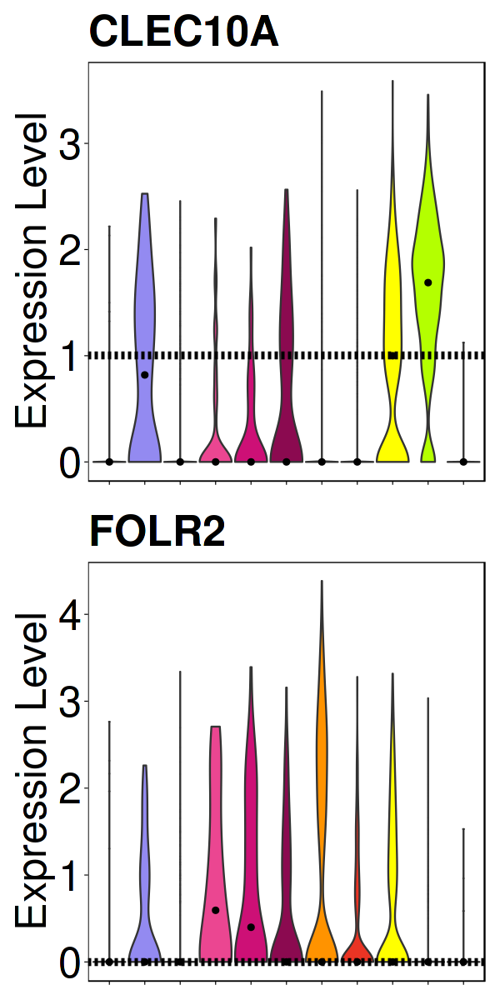

In [163]:
options(repr.plot.width=5, repr.plot.height=10)
x <- list()
DefaultAssay(glasgow3.FOLR2neg) <- "RNA"
for(gene in c("CLEC10A","FOLR2")){
      median <- median(glasgow3.FOLR2neg@assays$RNA@data[gene,glasgow3.FOLR2neg$clusters%in%c("SDS+NR4A3+CXCR4+ iDC3")])
  x[[paste0(gene,"1")]] <- VlnPlot(glasgow3.FOLR2neg, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30)) + geom_hline(yintercept=median, linetype="dashed", size=2, color = "black") + NoLegend()
}
plot_grid(plotlist=x, ncol=1)

## Differential protein expression in Glasgow 3 

In [164]:
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
protein.markers <- FindAllMarkers(glasgow3.FOLR2neg, test.use="MAST", min.pct=0.4)

Calculating cluster FCGR3A+ Monocyte

Calculating cluster CD14+FCGR3A+ Monocyte

Calculating cluster CD14highS100A12+ Monocyte


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!

Calculating cluster ISG15+ Intermediate


 Completed [==========>---------------------------------]  24% with 0 failures

 Completed [==========>---------------------------------]  25% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>------

In [165]:
protein.markers

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Hu.CD36,3.895263e-75,0.2788413,0.844,0.430,6.349278e-73,CD14highS100A12+ Monocyte,Hu.CD36
Hu.CD11a,2.216527e-58,0.3010562,0.939,0.798,3.612939e-56,CD14highS100A12+ Monocyte,Hu.CD11a
Hu.CD115,4.529462e-12,-0.5064355,0.341,0.825,7.383022e-10,ISG15+ Intermediate,Hu.CD115
Hu.CD127,5.694548e-12,-0.3703697,0.273,0.782,9.282113e-10,ISG15+ Intermediate,Hu.CD127
Hu.CD88,8.381436e-12,-0.4237840,0.295,0.798,1.366174e-09,ISG15+ Intermediate,Hu.CD88
Hu.CD192,1.192261e-11,-0.4820168,0.432,0.845,1.943385e-09,ISG15+ Intermediate,Hu.CD192
Hu.CD85j,1.836002e-11,-0.5340715,0.409,0.844,2.992684e-09,ISG15+ Intermediate,Hu.CD85j
Hu.Ig.LightChain.k,2.159197e-11,-0.4685010,0.409,0.865,3.519491e-09,ISG15+ Intermediate,Hu.Ig.LightChain.k
Hu.CD39,3.272417e-11,-0.3787107,0.386,0.849,5.334040e-09,ISG15+ Intermediate,Hu.CD39


In [166]:
unique(Idents(glasgow3.FOLR2neg))

[1] C1QAhighHMOX1+ Intermediate CD14highS100A12+ Monocyte  
 [3] SPP1+ Macrophage            SDS+NR4A3+CXCR4+ iDC3      
 [5] CD1c+ cDC                   TNF+ICAM1+ Macrophage      
 [7] CCR7+/CLEC9A+ DC1           ISG15+ Intermediate        
 [9] CD14+FCGR3A+ Monocyte       FCGR3A+ Monocyte           
[11] CXCL10+STAT1+ Macrophage   
11 Levels: FCGR3A+ Monocyte CD14+FCGR3A+ Monocyte ... CCR7+/CLEC9A+ DC1

In [167]:
glasgow3.FOLR2neg

An object of class Seurat 
19306 features across 4069 samples within 2 assays 
Active assay: ADT (163 features, 0 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

In [184]:
#Rename your clusters by celltype
Idents(glasgow3.FOLR2neg) <- "clusters"
glasgow3.FOLR2neg$DC <- plyr::revalue(as.character(Idents(glasgow3.FOLR2neg)),
                                        c("SDS+NR4A3+CXCR4+ iDC3"='DC',
                                         "CD1c+ cDC"='DC'))
Idents(glasgow3.FOLR2neg) <- "DC"

In [185]:
unique(Idents(glasgow3.FOLR2neg))

[1] C1QAhighHMOX1+ Intermediate CD14highS100A12+ Monocyte  
 [3] SPP1+ Macrophage            DC                         
 [5] TNF+ICAM1+ Macrophage       CCR7+/CLEC9A+ DC1          
 [7] ISG15+ Intermediate         CD14+FCGR3A+ Monocyte      
 [9] FCGR3A+ Monocyte            CXCL10+STAT1+ Macrophage   
10 Levels: C1QAhighHMOX1+ Intermediate ... CXCL10+STAT1+ Macrophage

In [188]:
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
Idents(glasgow3.FOLR2neg) <- "DC"
dcVsMac <- FindMarkers(glasgow3.FOLR2neg, ident.1=c("DC"), ident.2=c("SPP1+ Macrophage"),
                      test.use="MAST")


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



In [189]:
dcVsMac$gene <- rownames(dcVsMac)
dcVsMac

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
Hu.CD86,5.021757e-76,-0.2524115,0.752,0.818,8.185464e-74,Hu.CD86
Hu.CD1c,6.293971e-69,0.4478711,0.768,0.630,1.025917e-66,Hu.CD1c
Hu.CD32,4.206120e-54,0.2591699,0.817,0.811,6.855975e-52,Hu.CD32
Hu.CD39,4.337216e-53,0.2678302,0.865,0.844,7.069662e-51,Hu.CD39


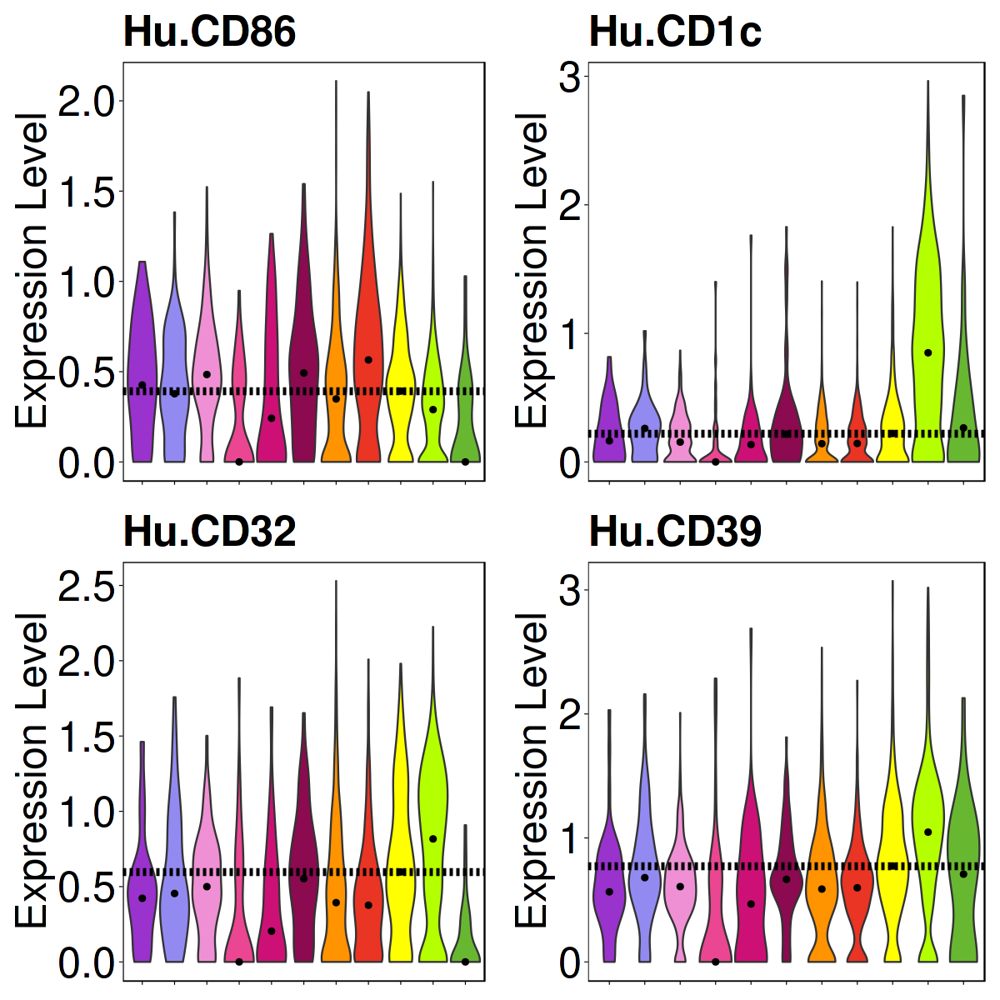

In [193]:
options(repr.plot.width=10, repr.plot.height=10)
x <- list()
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
Idents(glasgow3.FOLR2neg) <- "clusters"
for(protein in dcVsMac$gene){
      median <- median(glasgow3.FOLR2neg@assays$ADT@data[protein,glasgow3.FOLR2neg$clusters%in%c("SDS+NR4A3+CXCR4+ iDC3")])

  x[[paste0(protein,"1")]] <- VlnPlot(glasgow3.FOLR2neg, features=protein, pt.size=0,ncol=1, cols=clust.cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.text.y=element_text(size=30), axis.title.y=element_text(size=30), axis.title.x=element_blank()) + NoLegend() + geom_hline(yintercept=median, linetype="dashed", size=2, color = "black") + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

In [173]:
Idents(glasgow3.FOLR2neg) <- "DC"
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
dcVsMac <- FindMarkers(glasgow3.FOLR2neg, ident.1=c("DC"), ident.2=c("CD14highS100A12+ Monocyte"),
                      test.use="MAST")


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



In [174]:
dcVsMac$gene <- rownames(dcVsMac)
dcVsMac

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
Hu.HLA.DR.DP.DQ,3.897299e-101,0.2939148,0.877,0.941,6.352597e-99,Hu.HLA.DR.DP.DQ
Hu.CD36,3.085037e-76,-0.2971125,0.408,0.844,5.028611e-74,Hu.CD36
Hu.CD11a,1.498244e-53,-0.2834359,0.825,0.939,2.442138e-51,Hu.CD11a
Hu.CD1c,8.951760e-49,0.4271439,0.768,0.672,1.459137e-46,Hu.CD1c


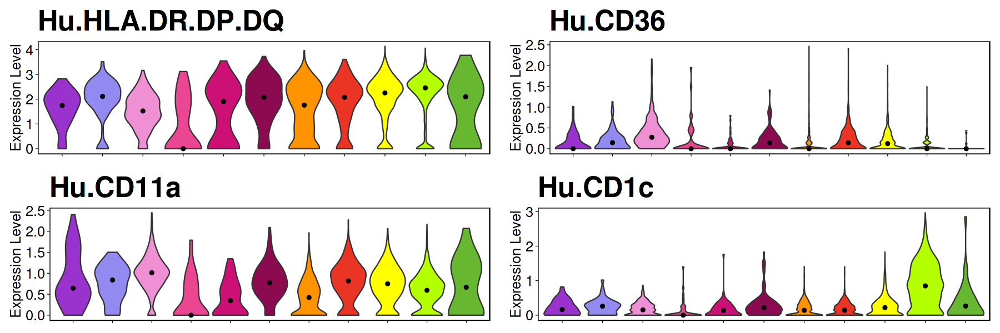

In [175]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3.FOLR2neg) <- "ADT"
Idents(glasgow3.FOLR2neg) <- "clusters"
for(protein in dcVsMac$gene){
  x[[paste0(protein,"1")]] <- VlnPlot(glasgow3.FOLR2neg, features=protein, pt.size=0,ncol=1, cols=clust.cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

In [ ]:
#Export annotations to dataframe
myeloid.anno <- as.data.frame(glasgow3.FOLR2neg$clusters)
myeloid.anno$clusters <- myeloid.anno$`glasgow3.FOLR2neg$clusters`
myeloid.anno$`glasgow3.FOLR2neg$clusters` <- NULL
myeloid.anno$barcode<-rownames(myeloid.anno)
head(myeloid.anno)

In [19]:
dc.only <- readRDS("/datastore/lucy/SynovialAtlas/CD1c/dc.only.rds")

In [20]:
dc.cols <- c("#7FCDF3", "#00689A","#0ec2a2","#43f782",
  "#a6ffef","#e5befb","#C876F7","#fdf0bb","#faf771","#fae071","#F8A640","#e38208","#FF6C67","#FF070A","#ce0062","#f776e6")
dc.only$clusters <- as.ordered(factor(dc.only$clusters, 
                                      levels=c('pre-DC CD5+AXL+SIGLEC6+',
                                               'DC1 CLEC9A+ (infiltrating)',
                                               'DC2 CD1c++AXL+',
                                               'DC2 CD1c++KLF4+ATF3+MRC1+',
                                                'DC2 CD1c++KLF4+ (infiltrating)',
                                               'DC2 MIR155HG+CCR7+ (activated)',
                                               'DC2 CCR7+LAMP3+ (migratory)',
                                               'DC2/3 CD1c+CRIP1+ (transitional)',
                                               "DC2/3 CD1c+ISG15+",
                                               'DC3 CD1c+CD14-CD163+ (infiltrating)',
                                               'DC3 CD1clowCD63+CD9+',
                                               'DC3 CD1clowTUBB4B+TIMP1+',
                                               'iDC3 CD1c-CD14lowCD163+ (infiltrating)',
                                               'iDC3 CD1c-FABP5+SDS+',
                                               'iDC3 CD1c-CLEC10A+FOLR2++C1QA+',
                                              'iDC3 CD1c-CLEC10A+NR4A3+')))
Idents(dc.only) <- "clusters"

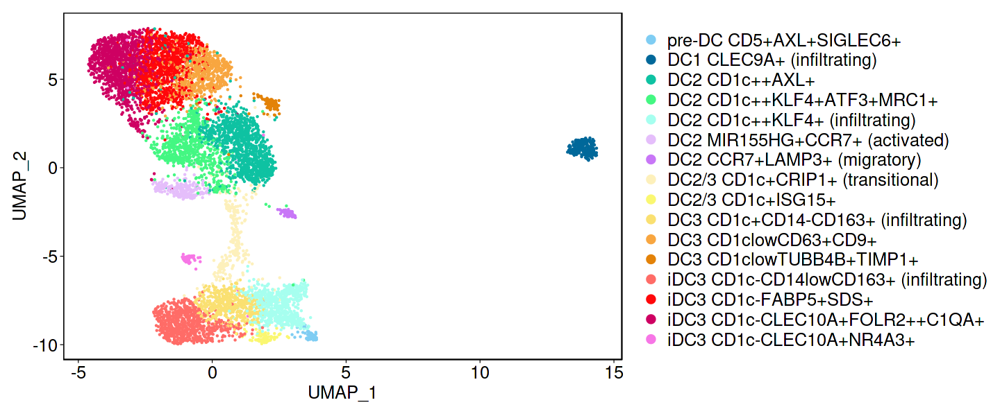

In [215]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(dc.only, cols=dc.cols, group.by="clusters") + theme_specific + theme(plot.title=element_blank(),legend.text=element_text(size=15))

In [216]:
#Export annotations to dataframe
dc.anno <- as.data.frame(dc.only$clusters)
dc.anno$clusters <- dc.anno$`dc.only$clusters`
dc.anno$`dc.only$clusters` <- NULL
dc.anno$barcode<-rownames(dc.anno)
head(dc.anno)

,clusters,barcode
,<fct>,<chr>
AACACGTAGAGCTGGT-1_1_1,iDC3 CD1c-FABP5+SDS+,AACACGTAGAGCTGGT-1_1_1
AACCATGAGAGTCGGT-1_1_1,iDC3 CD1c-FABP5+SDS+,AACCATGAGAGTCGGT-1_1_1
ACACCCTAGGATGGAA-1_1_1,iDC3 CD1c-CLEC10A+FOLR2++C1QA+,ACACCCTAGGATGGAA-1_1_1
ACACCCTTCAAACGGG-1_1_1,iDC3 CD1c-CLEC10A+FOLR2++C1QA+,ACACCCTTCAAACGGG-1_1_1
ACACCGGAGGCCCGTT-1_1_1,DC2 CD1c++AXL+,ACACCGGAGGCCCGTT-1_1_1
ACACTGACAGGTGCCT-1_1_1,DC2 CD1c++AXL+,ACACTGACAGGTGCCT-1_1_1


In [217]:
#Put myeloid and DC annotations together
combined.anno <- left_join(myeloid.anno, dc.anno, by="barcode")
head(combined.anno)

,clusters.x,barcode,clusters.y
,<fct>,<chr>,<fct>
1,C1QAhighHMOX1+ Intermediate,AAAGGTAAGTGATAGT-1_1_31,NA
2,CD14highS100A12+ Monocyte,AAAGTCCGTTCCTAGA-1_1_31,NA
3,SPP1+ Macrophage,AACAACCGTCGCCACA-1_1_31,NA
4,SDS+NR4A3+CXCR4+ iDC3,AACACACGTAGACACG-1_1_31,iDC3 CD1c-CD14lowCD163+ (infiltrating)
5,CD1c+ cDC,AACAGGGAGGCAGTCA-1_1_31,DC2 CD1c++AXL+
6,TNF+ICAM1+ Macrophage,AACAGGGGTCCGGACT-1_1_31,NA


In [218]:
#Take DC annotation unless value is NA
combined.anno$clusters <- ifelse(is.na(combined.anno$clusters.y), as.character(combined.anno$clusters.x), as.character(combined.anno$clusters.y))
rownames(combined.anno) <- combined.anno$barcode
head(combined.anno)

,clusters.x,barcode,clusters.y,clusters
,<fct>,<chr>,<fct>,<chr>
AAAGGTAAGTGATAGT-1_1_31,C1QAhighHMOX1+ Intermediate,AAAGGTAAGTGATAGT-1_1_31,NA,C1QAhighHMOX1+ Intermediate
AAAGTCCGTTCCTAGA-1_1_31,CD14highS100A12+ Monocyte,AAAGTCCGTTCCTAGA-1_1_31,NA,CD14highS100A12+ Monocyte
AACAACCGTCGCCACA-1_1_31,SPP1+ Macrophage,AACAACCGTCGCCACA-1_1_31,NA,SPP1+ Macrophage
AACACACGTAGACACG-1_1_31,SDS+NR4A3+CXCR4+ iDC3,AACACACGTAGACACG-1_1_31,iDC3 CD1c-CD14lowCD163+ (infiltrating),iDC3 CD1c-CD14lowCD163+ (infiltrating)
AACAGGGAGGCAGTCA-1_1_31,CD1c+ cDC,AACAGGGAGGCAGTCA-1_1_31,DC2 CD1c++AXL+,DC2 CD1c++AXL+
AACAGGGGTCCGGACT-1_1_31,TNF+ICAM1+ Macrophage,AACAGGGGTCCGGACT-1_1_31,NA,TNF+ICAM1+ Macrophage


In [219]:
glasgow3.FOLR2neg <- AddMetaData(glasgow3.FOLR2neg, combined.anno)

In [220]:
head(glasgow3.FOLR2neg@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.hb,percent.ribo,RNA_snn_res.0.1,seurat_clusters,pANN_0.25_0.09_3,Doublets.Low.Confidence,⋯,integrated.clusters,integrated.pb.clusters,tissue_condition,all.myeloid.clusters,RNA_snn_res.0.8,clusters.res0.8,barcode,subclusters,clusters.x,clusters.y
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<chr>,⋯,<chr>,<ord>,<ord>,<fct>,<fct>,<ord>,<chr>,<chr>,<fct>,<fct>
AAAGGTAAGTGATAGT-1_1_31,A1,617.8547,320,0.000000,0.000000000,24.490499,0,10,NA,Singlet,⋯,NA,NA,ST_Active RA,HMOX1+C1QA+ Macrophage,10,C1QAhighHMOX1+ Intermediate,AAAGGTAAGTGATAGT-1_1_31,NA,C1QAhighHMOX1+ Intermediate,NA
AAAGTCCGTTCCTAGA-1_1_31,A1,6321.4723,1967,4.395631,0.000000000,18.279197,0,12,NA,Singlet,⋯,NA,NA,ST_Active RA,S100A12+TIMP1+ Intermediate,12,CD14highS100A12+ Monocyte,AAAGTCCGTTCCTAGA-1_1_31,NA,CD14highS100A12+ Monocyte,NA
AACAACCGTCGCCACA-1_1_31,A1,12143.6119,2501,2.713785,0.000000000,6.553150,0,6,NA,Singlet,⋯,NA,NA,ST_Active RA,SPP1+TREM2low Macrophage,6,SPP1+ Macrophage,AACAACCGTCGCCACA-1_1_31,NA,SPP1+ Macrophage,NA
AACACACGTAGACACG-1_1_31,A1,13171.6601,3003,2.733643,0.007253484,22.113366,0,8,NA,Singlet,⋯,NA,NA,ST_Active RA,CLEC10A+ATF3+ Macrophage,8,SDS+NR4A3+CXCR4+ iDC3,AACACACGTAGACACG-1_1_31,NA,SDS+NR4A3+CXCR4+ iDC3,iDC3 CD1c-CD14lowCD163+ (infiltrating)
AACAGGGAGGCAGTCA-1_1_31,A1,11358.4415,2137,1.939376,0.000000000,31.223794,5,5,NA,Singlet,⋯,NA,NA,ST_Active RA,CD1c+ DC2/3,5,CD1c+ cDC,AACAGGGAGGCAGTCA-1_1_31,NA,CD1c+ cDC,DC2 CD1c++AXL+
AACAGGGGTCCGGACT-1_1_31,A1,4872.3855,1545,5.570320,0.000000000,7.842453,0,13,NA,Singlet,⋯,NA,NA,ST_Active RA,TNF+ICAM1+ Macrophage,13,TNF+ICAM1+ Macrophage,AACAGGGGTCCGGACT-1_1_31,NA,TNF+ICAM1+ Macrophage,NA


In [221]:
unique(glasgow3.FOLR2neg$clusters)

[1] "C1QAhighHMOX1+ Intermediate"           
 [2] "CD14highS100A12+ Monocyte"             
 [3] "SPP1+ Macrophage"                      
 [4] "iDC3 CD1c-CD14lowCD163+ (infiltrating)"
 [5] "DC2 CD1c++AXL+"                        
 [6] "TNF+ICAM1+ Macrophage"                 
 [7] "iDC3 CD1c-CLEC10A+FOLR2++C1QA+"        
 [8] "DC2 CD1c++KLF4+ (infiltrating)"        
 [9] "iDC3 CD1c-FABP5+SDS+"                  
[10] "DC3 CD1clowTUBB4B+TIMP1+"              
[11] "pre-DC CD5+AXL+SIGLEC6+"               
[12] "SDS+NR4A3+CXCR4+ iDC3"                 
[13] "DC2 CD1c++KLF4+ATF3+MRC1+"             
[14] "DC1 CLEC9A+ (infiltrating)"            
[15] "ISG15+ Intermediate"                   
[16] "CD14+FCGR3A+ Monocyte"                 
[17] "FCGR3A+ Monocyte"                      
[18] "CXCL10+STAT1+ Macrophage"              
[19] "DC3 CD1clowCD63+CD9+"                  
[20] "DC3 CD1c+CD14-CD163+ (infiltrating)"   
[21] "DC2 MIR155HG+CCR7+ (activated)"        
[22] "CD1c+ cDC"                             
[23] "DC2 CCR7+LAMP3+ (migratory)"           
[24] "DC2/3 CD1c+ISG15+"                     
[25] "DC2/3 CD1c+CRIP1+ (transitional)"      
[26] "iDC3 CD1c-CLEC10A+NR4A3+"              
[27] "CCR7+/CLEC9A+ DC1"

In [223]:
Idents(glasgow3.FOLR2neg) <- "clusters"
glasgow3.FOLR2neg <- subset(glasgow3.FOLR2neg, idents=c("CD1c+ cDC","iDC3 CD1c-CLEC10A+NR4A3+","DC2/3 CD1c+ISG15+","CCR7+/CLEC9A+ DC1","pre-DC CD5+AXL+SIGLEC6+","SDS+NR4A3+CXCR4+ iDC3"), invert=TRUE)

In [224]:
glasgow3.FOLR2neg$clusters <- as.ordered(factor(glasgow3.FOLR2neg$clusters, levels=c("FCGR3A+ Monocyte","CD14+FCGR3A+ Monocyte","CD14highS100A12+ Monocyte",
                                                                               "ISG15+ Intermediate",'CXCL10+STAT1+ Macrophage',"TNF+ICAM1+ Macrophage",'C1QAhighHMOX1+ Intermediate',
                                                                "SPP1+ Macrophage","SPP1+TREM2low Macrophage","TREM2+ Macrophage", "FOLR2highLYVE1+ Macrophage","FOLR2highSELENOP+ Macrophage",
                                                                               "FOLR2highEGR1+ Macrophage","FOLR2highCLEC10A+ Macrophage",
                                                               
                                               'DC1 CLEC9A+ (infiltrating)',
                                               'DC2 CD1c++AXL+',
                                               'DC2 CD1c++KLF4+ATF3+MRC1+',
                                                'DC2 CD1c++KLF4+ (infiltrating)',
                                               'DC2 MIR155HG+CCR7+ (activated)',
                                               'DC2 CCR7+LAMP3+ (migratory)',
                                               'DC2/3 CD1c+CRIP1+ (transitional)',
                                               'DC3 CD1c+CD14-CD163+ (infiltrating)',
                                               'DC3 CD1clowCD63+CD9+',
                                               'DC3 CD1clowTUBB4B+TIMP1+',
                                               'iDC3 CD1c-CD14lowCD163+ (infiltrating)',
                                               'iDC3 CD1c-FABP5+SDS+',
                                               'iDC3 CD1c-CLEC10A+FOLR2++C1QA+'
                                                            )))
Idents(glasgow3.FOLR2neg) <- "clusters"


In [225]:
new.cols <- c("grey","grey",
                  "grey", "grey","grey","grey","grey",
      "grey",
             "#00689A","#0ec2a2","#43f782",
  "#a6ffef","#e5befb","#C876F7","#fdf0bb","#fae071","#F8A640","#e38208","#FF6C67","#FF070A","#ce0062")

In [226]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(glasgow3.FOLR2neg@meta.data),Embeddings(glasgow3.FOLR2neg, reduction = "umap")[,1], Embeddings(glasgow3.FOLR2neg, reduction = "umap")[,2],
                   glasgow3.FOLR2neg$Tissue,glasgow3.FOLR2neg$condition,glasgow3.FOLR2neg$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "Tissue", "Group", "Cluster")

#Save
write.csv(umap, "single.cell-umap.plot.csv")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")

In [227]:
umap$Cluster <- as.ordered(factor(umap$Cluster, levels=levels(glasgow3.FOLR2neg$clusters)))
umap <- umap[order(umap$Cluster),]

In [228]:
levels(umap$Cluster)

[1] "FCGR3A+ Monocyte"                      
 [2] "CD14+FCGR3A+ Monocyte"                 
 [3] "CD14highS100A12+ Monocyte"             
 [4] "ISG15+ Intermediate"                   
 [5] "CXCL10+STAT1+ Macrophage"              
 [6] "TNF+ICAM1+ Macrophage"                 
 [7] "C1QAhighHMOX1+ Intermediate"           
 [8] "SPP1+ Macrophage"                      
 [9] "DC1 CLEC9A+ (infiltrating)"            
[10] "DC2 CD1c++AXL+"                        
[11] "DC2 CD1c++KLF4+ATF3+MRC1+"             
[12] "DC2 CD1c++KLF4+ (infiltrating)"        
[13] "DC2 MIR155HG+CCR7+ (activated)"        
[14] "DC2 CCR7+LAMP3+ (migratory)"           
[15] "DC2/3 CD1c+CRIP1+ (transitional)"      
[16] "DC3 CD1c+CD14-CD163+ (infiltrating)"   
[17] "DC3 CD1clowCD63+CD9+"                  
[18] "DC3 CD1clowTUBB4B+TIMP1+"              
[19] "iDC3 CD1c-CD14lowCD163+ (infiltrating)"
[20] "iDC3 CD1c-FABP5+SDS+"                  
[21] "iDC3 CD1c-CLEC10A+FOLR2++C1QA+"

In [229]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15))

In [230]:
names(new.cols) <- levels(glasgow3.FOLR2neg$clusters)

In [231]:
umap <- umap[order(umap$ID),]

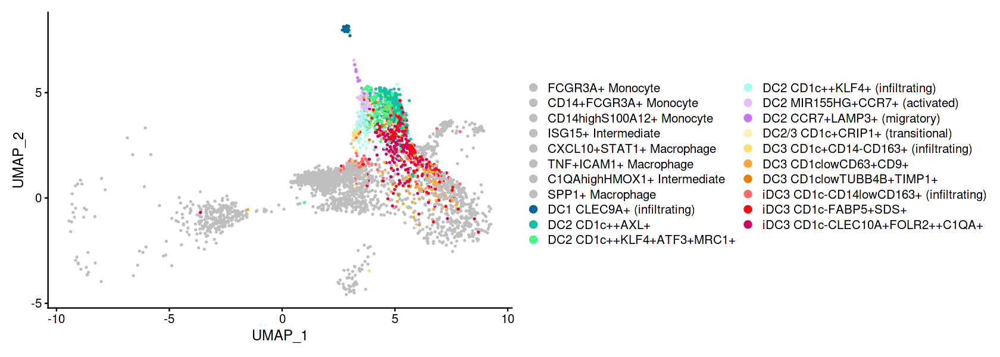

In [232]:
options(repr.plot.width=14, repr.plot.height=5)
DimPlot(glasgow3.FOLR2neg, cols=new.cols)

In [233]:
unique(glasgow3.FOLR2neg$clusters)

[1] C1QAhighHMOX1+ Intermediate           
 [2] CD14highS100A12+ Monocyte             
 [3] SPP1+ Macrophage                      
 [4] iDC3 CD1c-CD14lowCD163+ (infiltrating)
 [5] DC2 CD1c++AXL+                        
 [6] TNF+ICAM1+ Macrophage                 
 [7] iDC3 CD1c-CLEC10A+FOLR2++C1QA+        
 [8] DC2 CD1c++KLF4+ (infiltrating)        
 [9] iDC3 CD1c-FABP5+SDS+                  
[10] DC3 CD1clowTUBB4B+TIMP1+              
[11] DC2 CD1c++KLF4+ATF3+MRC1+             
[12] DC1 CLEC9A+ (infiltrating)            
[13] ISG15+ Intermediate                   
[14] CD14+FCGR3A+ Monocyte                 
[15] FCGR3A+ Monocyte                      
[16] CXCL10+STAT1+ Macrophage              
[17] DC3 CD1clowCD63+CD9+                  
[18] DC3 CD1c+CD14-CD163+ (infiltrating)   
[19] DC2 MIR155HG+CCR7+ (activated)        
[20] DC2 CCR7+LAMP3+ (migratory)           
[21] DC2/3 CD1c+CRIP1+ (transitional)      
21 Levels: FCGR3A+ Monocyte CD14+FCGR3A+ Monocyte ... iDC3 CD1c-CLEC10A+FOLR2++C1QA+

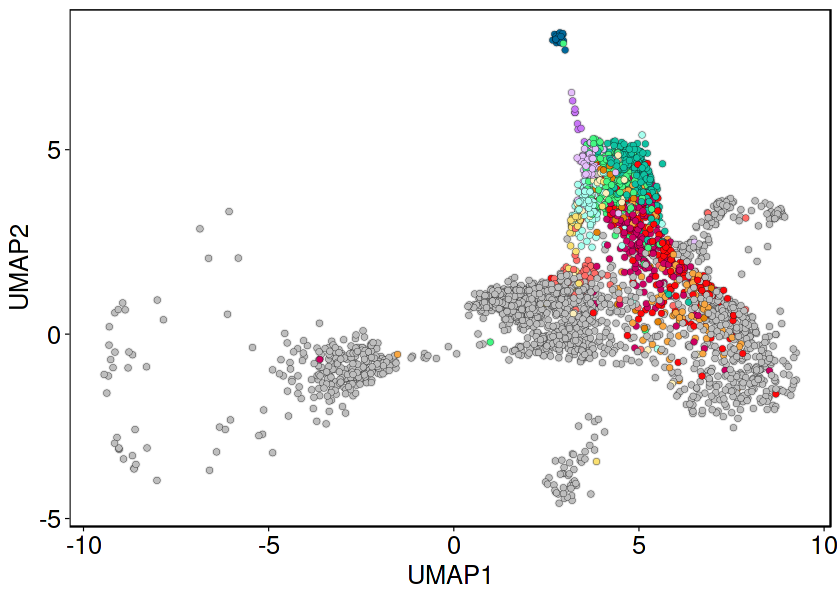

In [234]:
options(repr.plot.width=7, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(aes(fill=factor(Cluster)),color="black", size=1.5, shape=21, stroke = 1/10) + 
  scale_fill_manual(name=NULL, labels = levels(umap$Cluster), guide="legend", values=new.cols) + theme_specific + guides(fill=FALSE)

In [194]:
Idents(glasgow3.FOLR2neg) <- "clusters"
glasgow3.avg <- AverageExpression(glasgow3.FOLR2neg, return.seurat=TRUE, assay="ADT")

Centering and scaling data matrix



In [195]:
glasgow3.avg <- ScaleData(glasgow3.avg)

Centering and scaling data matrix



In [196]:
Idents(glasgow3.avg)

FCGR3A+ Monocyte       CD14+FCGR3A+ Monocyte 
           FCGR3A+ Monocyte       CD14+FCGR3A+ Monocyte 
  CD14highS100A12+ Monocyte         ISG15+ Intermediate 
  CD14highS100A12+ Monocyte         ISG15+ Intermediate 
   CXCL10+STAT1+ Macrophage       TNF+ICAM1+ Macrophage 
   CXCL10+STAT1+ Macrophage       TNF+ICAM1+ Macrophage 
C1QAhighHMOX1+ Intermediate            SPP1+ Macrophage 
C1QAhighHMOX1+ Intermediate            SPP1+ Macrophage 
      SDS+NR4A3+CXCR4+ iDC3                   CD1c+ cDC 
      SDS+NR4A3+CXCR4+ iDC3                   CD1c+ cDC 
          CCR7+/CLEC9A+ DC1 
          CCR7+/CLEC9A+ DC1 
11 Levels: FCGR3A+ Monocyte CD14+FCGR3A+ Monocyte ... CCR7+/CLEC9A+ DC1

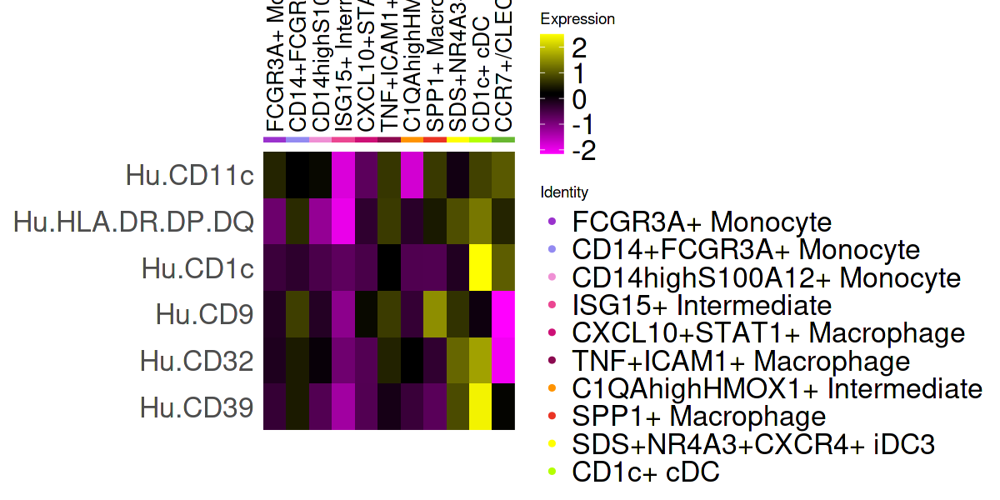

In [199]:
options(repr.plot.width=10, repr.plot.height=5)
DoHeatmap(glasgow3.avg, features=c("Hu.CD11c","Hu.HLA.DR.DP.DQ","Hu.CD1c","Hu.CD9","Hu.CD32","Hu.CD39"),
          group.colors=clust.cols, draw.lines=FALSE,angle = 90) + theme(axis.text.y=element_text(size=20), legend.text=element_text(size=20))